In [ ]:
! git clone https://github.com/AkshaymShende/Mask-RCNN.git

Cloning into 'Mask-RCNN'...
remote: Enumerating objects: 26, done.
remote: Counting objects: 100% (26/26), done.
remote: Compressing objects: 100% (22/22), done.
remote: Total 26 (delta 8), reused 18 (delta 4), pack-reused 0
Unpacking objects: 100% (26/26), done.


## MASKING IMAGE

In [ ]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
import tensorflow_hub as hub
import tensorflow as tf
import imutils

In [ ]:
IMAGE_PATH = '/content/Mask-RCNN/runners.jpg'
LABELS = ['','person','bicycle','car','motorcycle']
COLORS = [(0,0,255),(0,255,0),(255,0,0)]
COLORS = [np.array(i).astype(int) for i in COLORS]

(400, 800, 3)


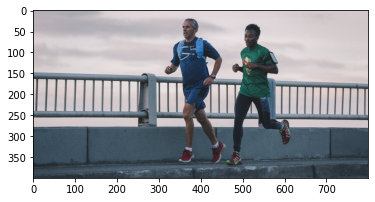

In [ ]:
# preprocessing image 

image = cv2.imread(IMAGE_PATH)
image = imutils.resize(image,800)
rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

print(rgb.shape)
plt.imshow(rgb)

In [ ]:
# converting to tensors for inserting into model

image_tensor = tf.convert_to_tensor(rgb , dtype=tf.uint8)

image_tensor = tf.expand_dims(image_tensor, axis=0)

image_tensor

<tf.Tensor: shape=(1, 400, 800, 3), dtype=uint8, numpy=
array([[[[180, 175, 182],
         [179, 174, 181],
         [174, 169, 176],
         ...,
         [211, 202, 203],
         [212, 203, 204],
         [210, 201, 202]],

        [[179, 174, 181],
         [180, 175, 182],
         [178, 173, 180],
         ...,
         [210, 201, 202],
         [208, 199, 200],
         [210, 201, 202]],

        [[181, 176, 183],
         [180, 175, 182],
         [178, 173, 180],
         ...,
         [212, 203, 204],
         [210, 201, 202],
         [210, 201, 202]],

        ...,

        [[ 44,  54,  63],
         [ 40,  50,  59],
         [ 45,  55,  64],
         ...,
         [ 62,  73,  82],
         [ 57,  69,  77],
         [ 58,  71,  79]],

        [[ 39,  48,  55],
         [ 41,  50,  57],
         [ 48,  57,  64],
         ...,
         [ 53,  66,  75],
         [ 52,  66,  75],
         [ 54,  68,  77]],

        [[ 43,  52,  59],
         [ 40,  49,  56],
         [ 43,  52

In [ ]:
# loading Mask RCNN model from tensorflow

detector = hub.load("https://tfhub.dev/tensorflow/mask_rcnn/inception_resnet_v2_1024x1024/1")


In [ ]:
# running model

detector_output = detector(image_tensor)

In [ ]:
detector_output.keys()

dict_keys(['rpn_objectness_predictions_with_background', 'detection_multiclass_scores', 'proposal_boxes_normalized', 'mask_predictions', 'detection_anchor_indices', 'class_predictions_with_background', 'rpn_box_encodings', 'detection_scores', 'detection_masks', 'refined_box_encodings', 'box_classifier_features', 'rpn_box_predictor_features', 'rpn_features_to_crop', 'num_detections', 'num_proposals', 'final_anchors', 'raw_detection_scores', 'proposal_boxes', 'anchors', 'raw_detection_boxes', 'detection_classes', 'image_shape', 'detection_boxes'])

In [ ]:
# fetching outputs

classes = detector_output["detection_classes"][0].numpy().astype(int)
masks = detector_output["detection_masks"][0].numpy()
boxes = detector_output["detection_boxes"][0].numpy()
scores = detector_output["detection_scores"][0].numpy()


(341, 149, 3)
(333, 149, 3)
 


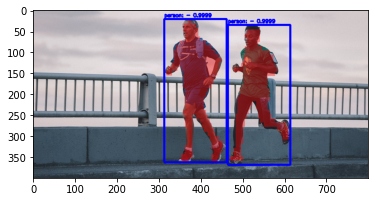

In [ ]:
clone = rgb.copy()

(H,W) = rgb.shape[:2]



for score, (ymin,xmin,ymax,xmax), label, mask in zip(scores,boxes,classes,masks):

  if score >0.8:

    (ymin,xmin,ymax,xmax) = ((ymin,xmin,ymax,xmax)*np.array([H,W,H,W])).astype(int)

    mask = (mask*255).astype("uint8")

    # image segmentation - masks

    roi = clone[ymin:ymax,xmin:xmax]
    shoe_crop =roi.copy()
    print(roi.shape)

    roi_height = ymax - ymin
    roi_width = xmax - xmin

    # Masking and fetching instance
    mask_fetch = cv2.resize(mask,(roi_width, roi_height),interpolation=cv2.INTER_NEAREST)
    instance = cv2.bitwise_and(roi,roi,mask=mask_fetch)

    # 70% threshold for predicted value of each pixel
    masking = (mask_fetch > 0.7*255)
    
    # blending mask with ROI
    roi_mask = roi[masking]
    blend = ((0.4* (np.array([255,0,0]).astype(int))) + (0.6*roi_mask)).astype("uint8")

    rgb[ymin:ymax,xmin:xmax][masking] = blend

    # object detection - boxes
    img = cv2.rectangle(rgb , (xmin,ymin), (xmax,ymax), (0,0,255),3)
    text = "{}: - {:.4f}".format(LABELS[label],score)
    img = cv2.putText( img, text, (xmin,ymin-5),cv2.FONT_HERSHEY_SIMPLEX, 0.40, (0,0,255),2)

    # cropping picture of shoes from mask

    # shoes = cv2.bitwise_and(shoe_crop[200:,:],shoe_crop[200:,:],mask=mask_fetch[200:,:])
    # shoes = cv2.resize(shoes,(800,800))
    # print("resized shoe picture :",shoes.shape)
    # plt.imshow(shoes)
    # plt.show()

# cv2_imshow(img)
print(" ")
plt.imshow(img)
plt.show()


## FOR VIDEO

In [1]:
! git clone https://github.com/AkshaymShende/Mask-RCNN.git

Cloning into 'Mask-RCNN'...
remote: Enumerating objects: 29, done.
remote: Counting objects: 100% (29/29), done.
remote: Compressing objects: 100% (24/24), done.
remote: Total 29 (delta 10), reused 20 (delta 5), pack-reused 0
Unpacking objects: 100% (29/29), done.
Checking out files: 100% (9/9), done.


## OBJECT TRACKING

In [ ]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
import tensorflow_hub as hub
import tensorflow as tf
import imutils
import dlib
import time
from imutils.video import FPS

In [ ]:
LABELS = ['','person','bicycle','car','motorcycle']
COLORS = [(0,0,255),(0,255,0),(255,0,0)]
COLORS = [np.array(i).astype(int) for i in COLORS]
threshold = 0.7*255

In [ ]:
vs = cv2.VideoCapture('/content/Mask-RCNN/marathon-video.mp4')
writer = None

# initialize the list of object trackers and corresponding class
# labels
trackers = []
labels = []
mask_list =[]

# start the frames per second throughput estimator
fps = FPS().start()

In [ ]:
# initializing model
detector = hub.load("https://tfhub.dev/tensorflow/mask_rcnn/inception_resnet_v2_1024x1024/1")

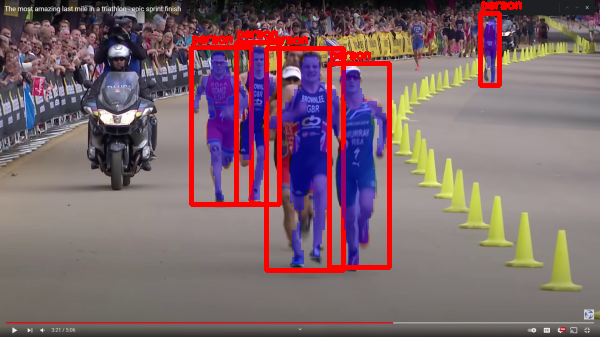

[INFO] elapsed time: 105.11
[INFO] approx. FPS: 0.01


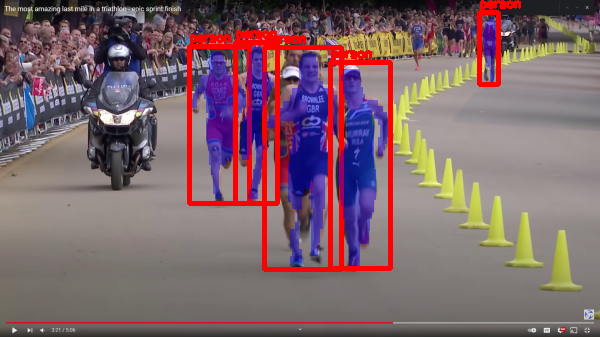

[INFO] elapsed time: 105.33
[INFO] approx. FPS: 0.02


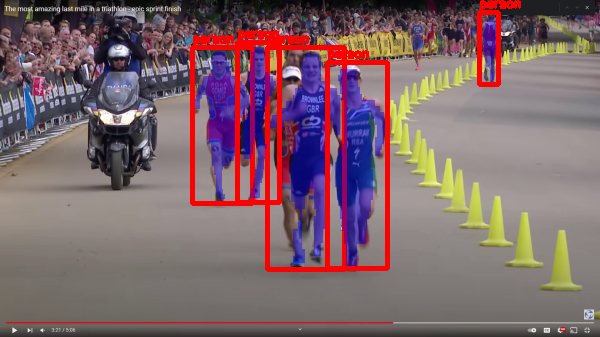

[INFO] elapsed time: 105.52
[INFO] approx. FPS: 0.03


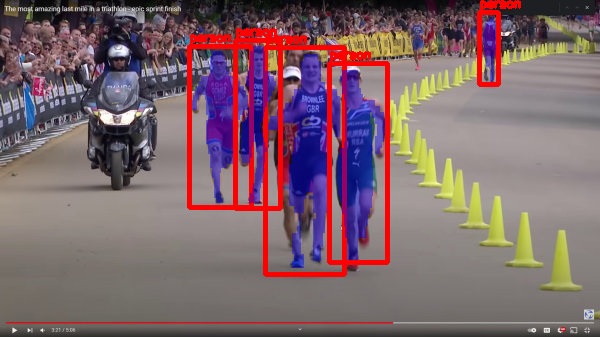

[INFO] elapsed time: 105.70
[INFO] approx. FPS: 0.04


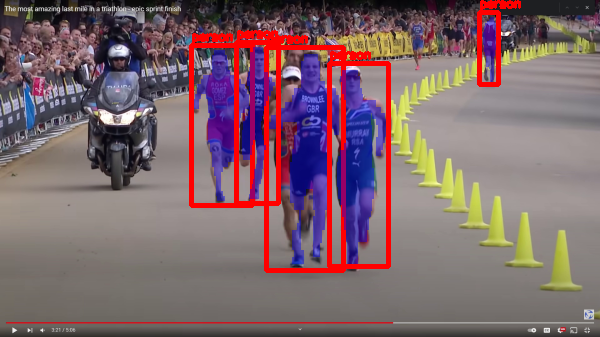

[INFO] elapsed time: 105.89
[INFO] approx. FPS: 0.05


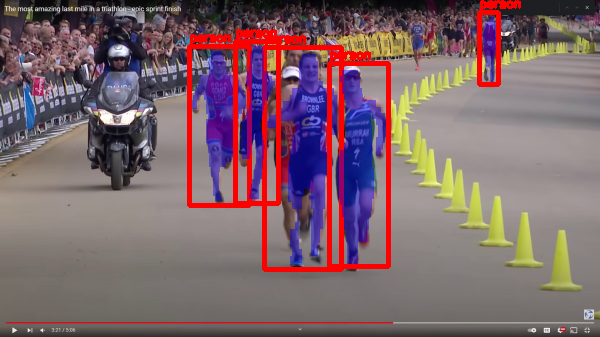

[INFO] elapsed time: 106.08
[INFO] approx. FPS: 0.06


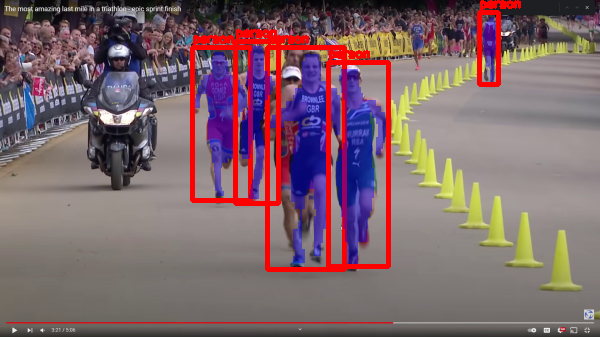

[INFO] elapsed time: 106.27
[INFO] approx. FPS: 0.07


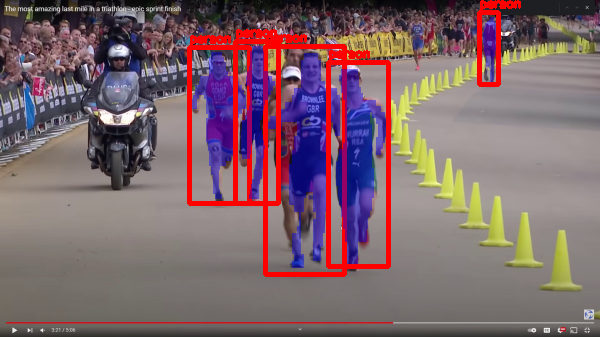

[INFO] elapsed time: 106.51
[INFO] approx. FPS: 0.08


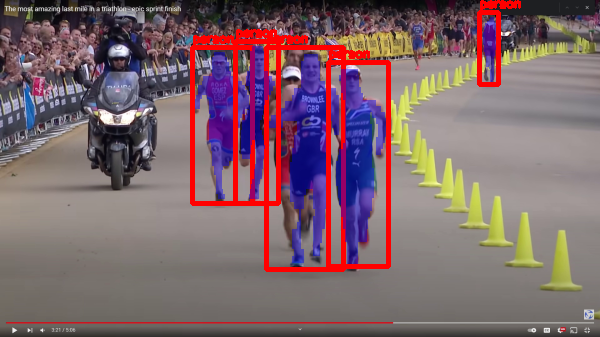

[INFO] elapsed time: 106.73
[INFO] approx. FPS: 0.08


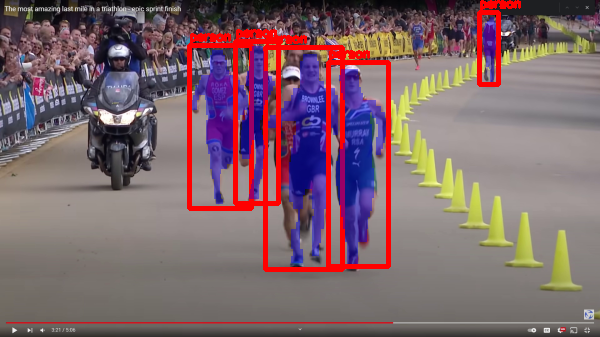

[INFO] elapsed time: 106.93
[INFO] approx. FPS: 0.09


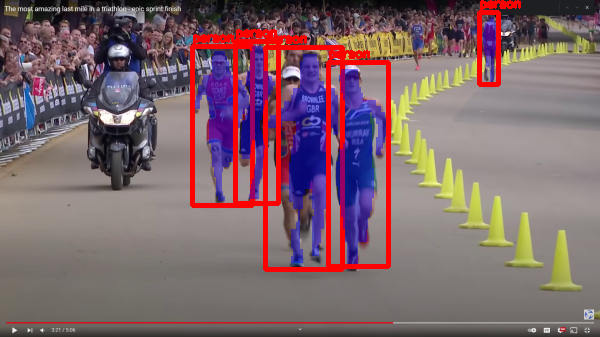

[INFO] elapsed time: 107.16
[INFO] approx. FPS: 0.10


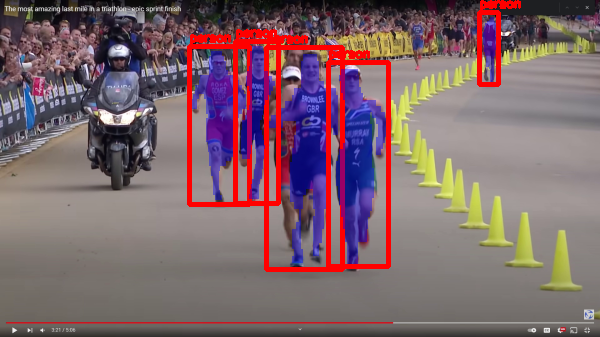

[INFO] elapsed time: 107.36
[INFO] approx. FPS: 0.11


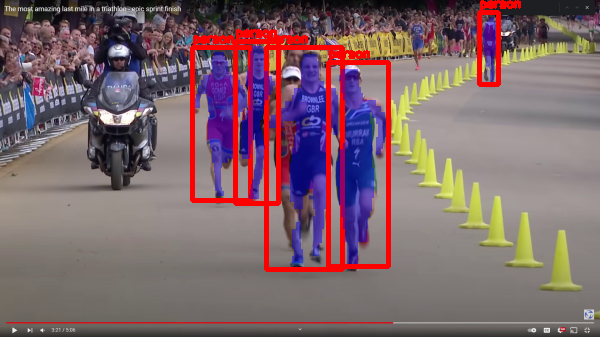

[INFO] elapsed time: 107.57
[INFO] approx. FPS: 0.12


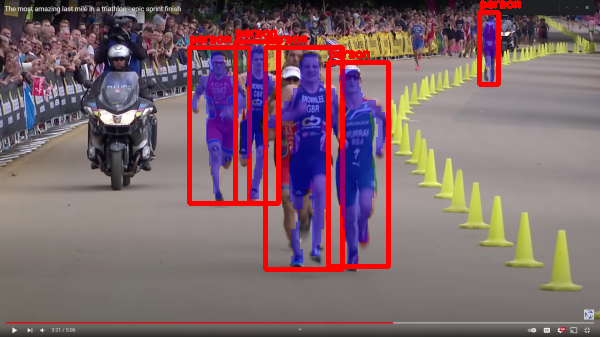

[INFO] elapsed time: 107.81
[INFO] approx. FPS: 0.13


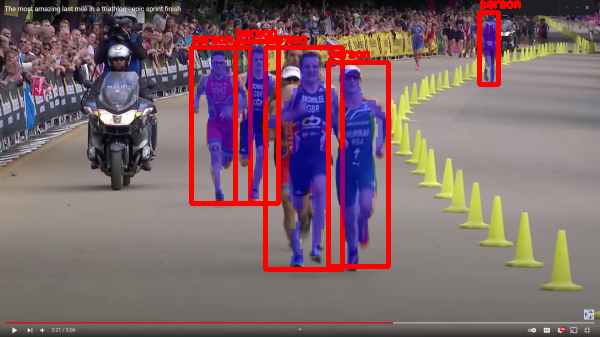

[INFO] elapsed time: 108.00
[INFO] approx. FPS: 0.14


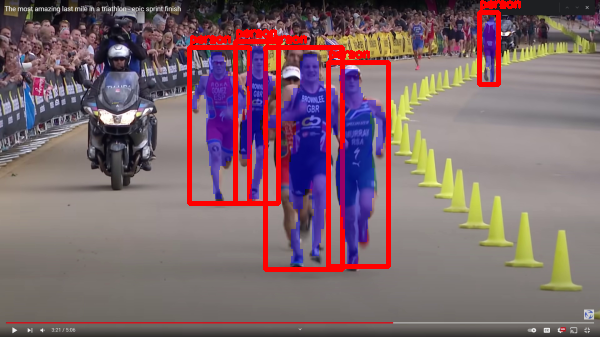

[INFO] elapsed time: 108.26
[INFO] approx. FPS: 0.15


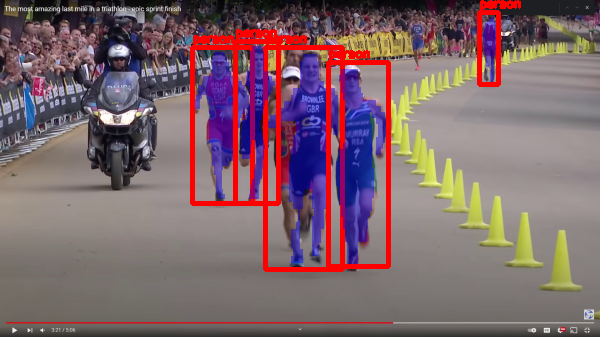

[INFO] elapsed time: 108.55
[INFO] approx. FPS: 0.16


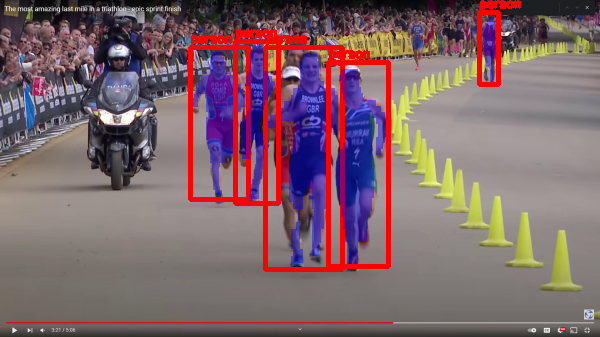

[INFO] elapsed time: 108.76
[INFO] approx. FPS: 0.17


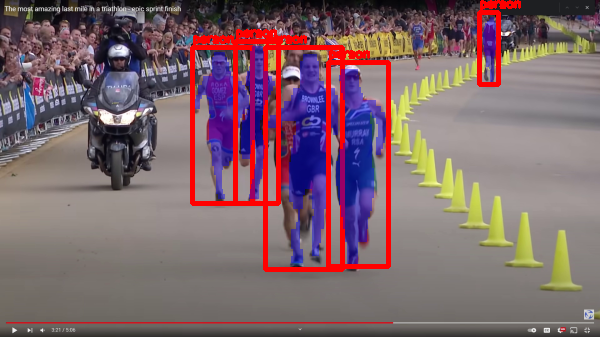

[INFO] elapsed time: 108.99
[INFO] approx. FPS: 0.17


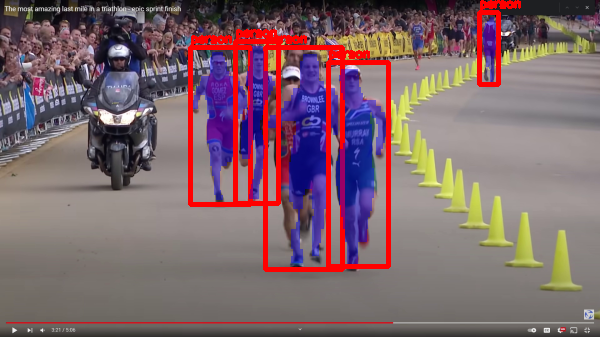

[INFO] elapsed time: 109.20
[INFO] approx. FPS: 0.18


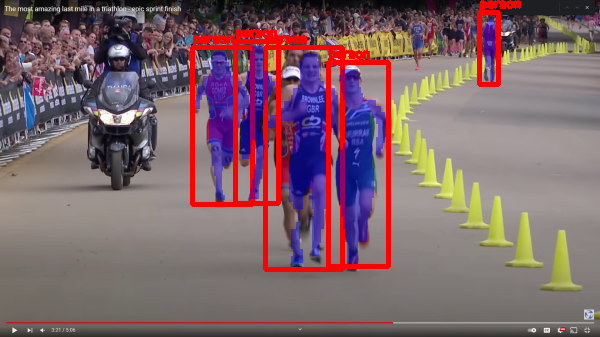

[INFO] elapsed time: 109.42
[INFO] approx. FPS: 0.19


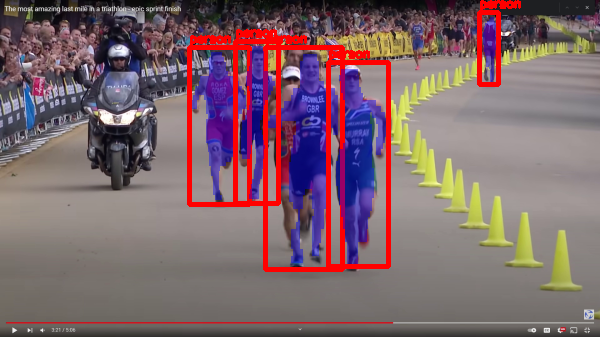

[INFO] elapsed time: 109.66
[INFO] approx. FPS: 0.20


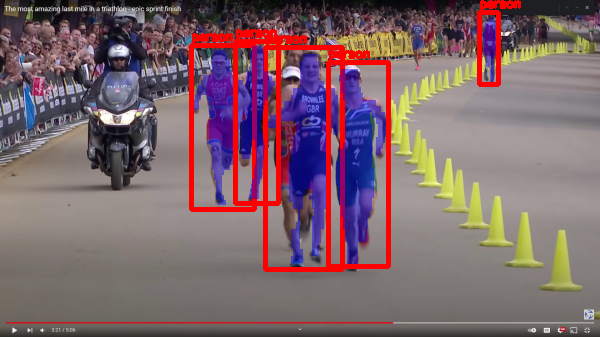

[INFO] elapsed time: 109.88
[INFO] approx. FPS: 0.21


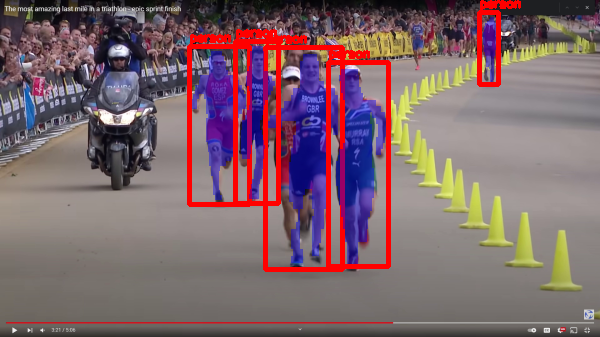

[INFO] elapsed time: 110.13
[INFO] approx. FPS: 0.22


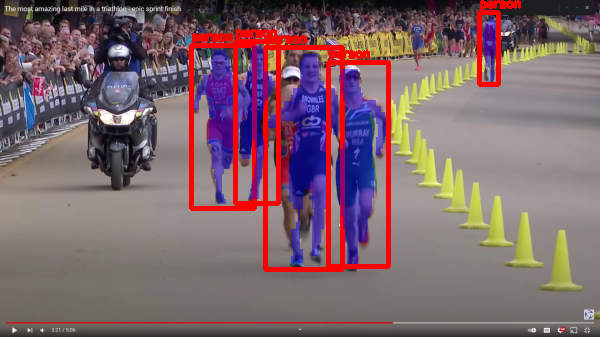

[INFO] elapsed time: 110.43
[INFO] approx. FPS: 0.23


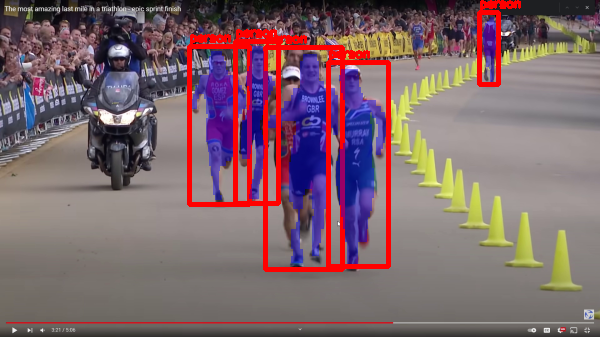

[INFO] elapsed time: 110.76
[INFO] approx. FPS: 0.23


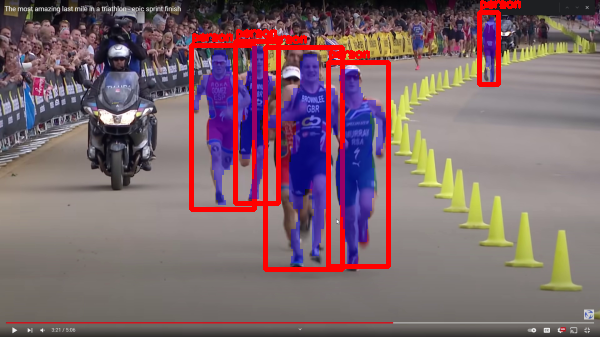

[INFO] elapsed time: 110.98
[INFO] approx. FPS: 0.24


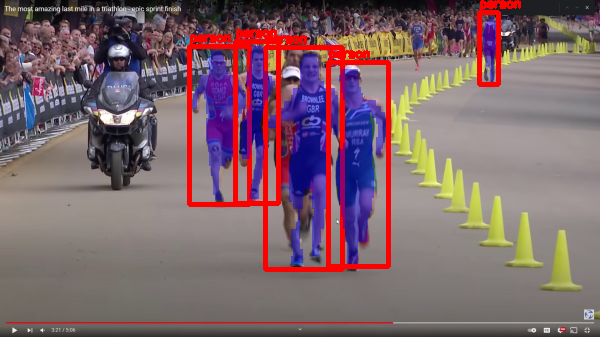

[INFO] elapsed time: 111.21
[INFO] approx. FPS: 0.25


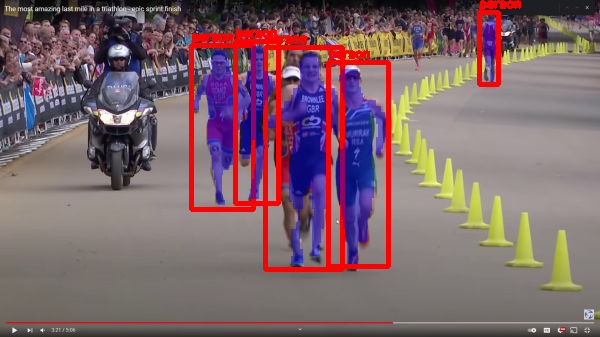

[INFO] elapsed time: 111.44
[INFO] approx. FPS: 0.26


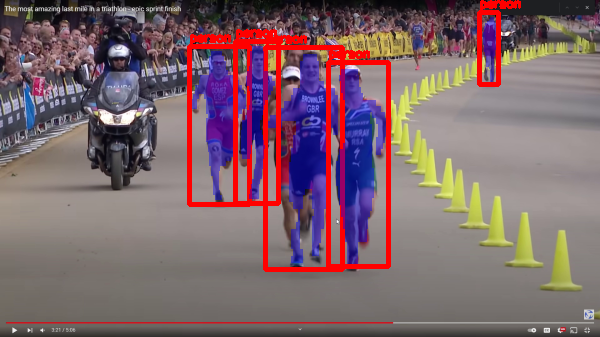

[INFO] elapsed time: 111.70
[INFO] approx. FPS: 0.27


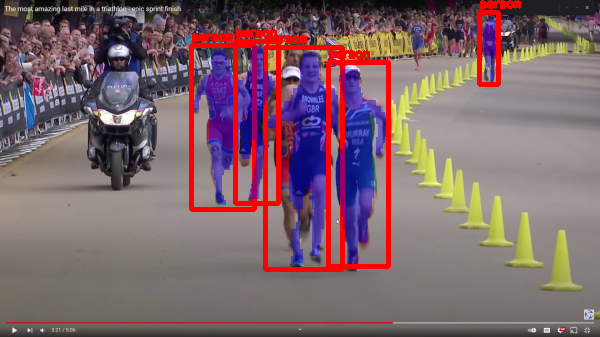

[INFO] elapsed time: 111.94
[INFO] approx. FPS: 0.28


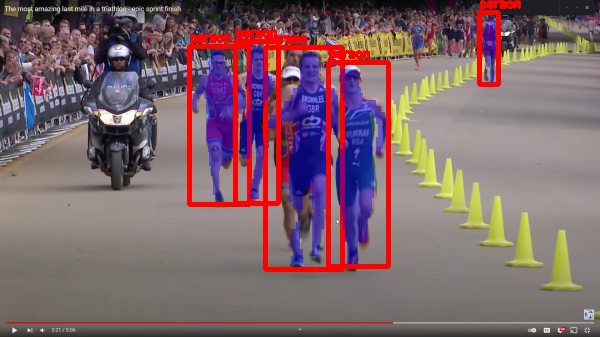

[INFO] elapsed time: 112.19
[INFO] approx. FPS: 0.29


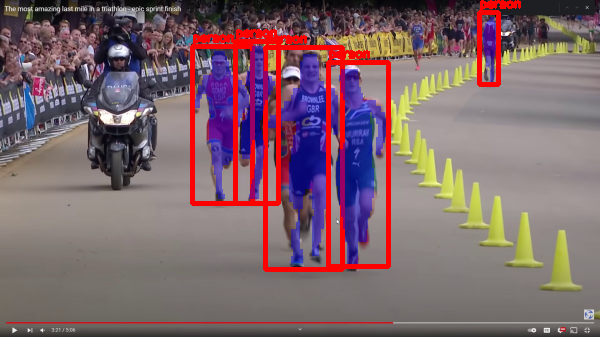

[INFO] elapsed time: 112.43
[INFO] approx. FPS: 0.29


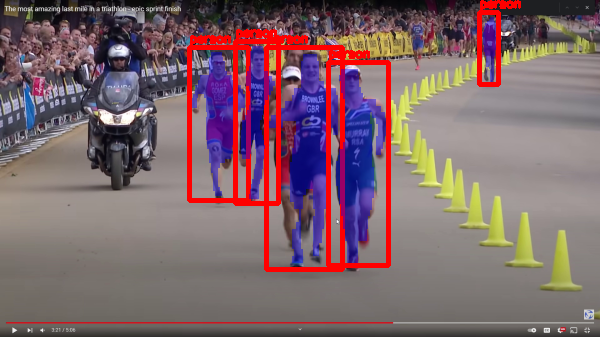

[INFO] elapsed time: 112.85
[INFO] approx. FPS: 0.30


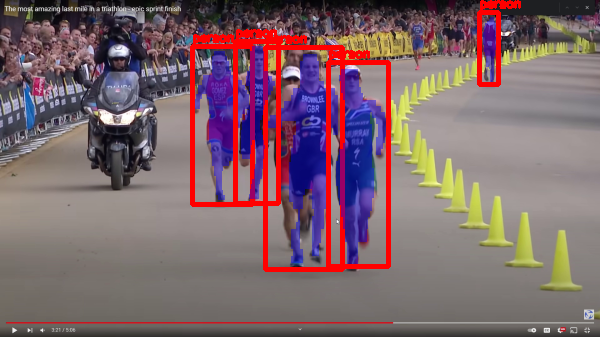

[INFO] elapsed time: 113.09
[INFO] approx. FPS: 0.31


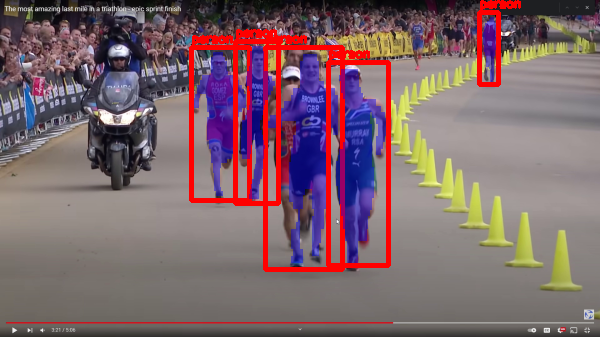

[INFO] elapsed time: 113.36
[INFO] approx. FPS: 0.32


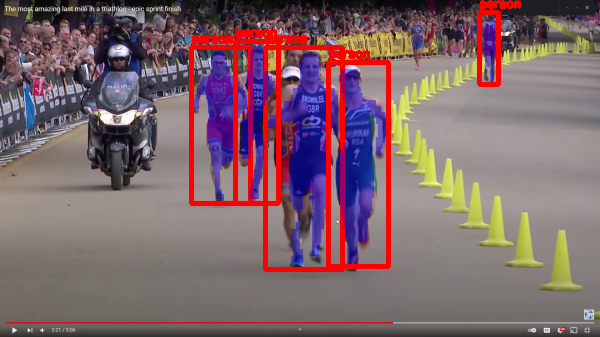

[INFO] elapsed time: 113.59
[INFO] approx. FPS: 0.33


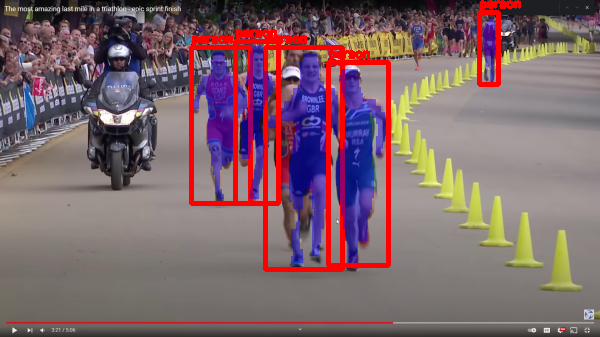

[INFO] elapsed time: 113.85
[INFO] approx. FPS: 0.33


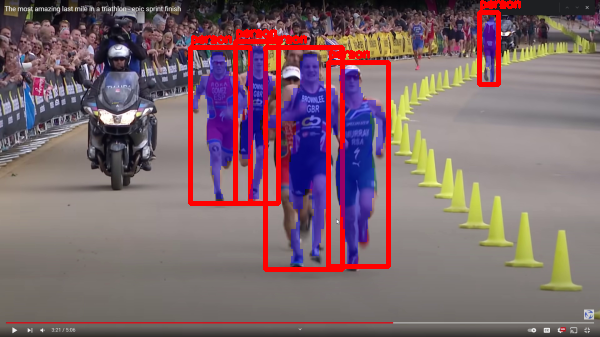

[INFO] elapsed time: 114.09
[INFO] approx. FPS: 0.34


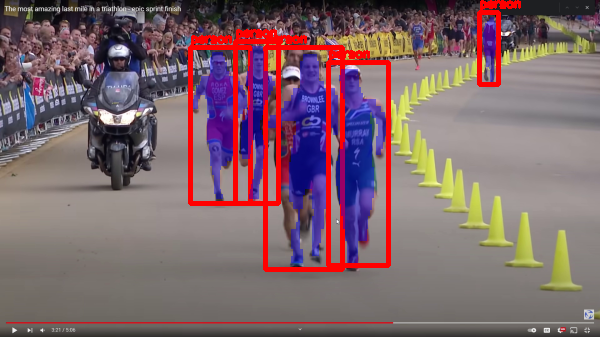

[INFO] elapsed time: 114.38
[INFO] approx. FPS: 0.35


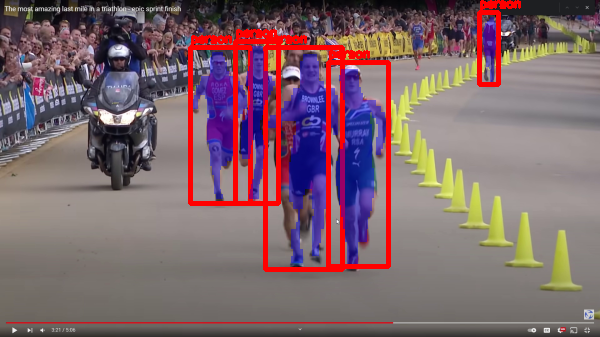

[INFO] elapsed time: 114.77
[INFO] approx. FPS: 0.36


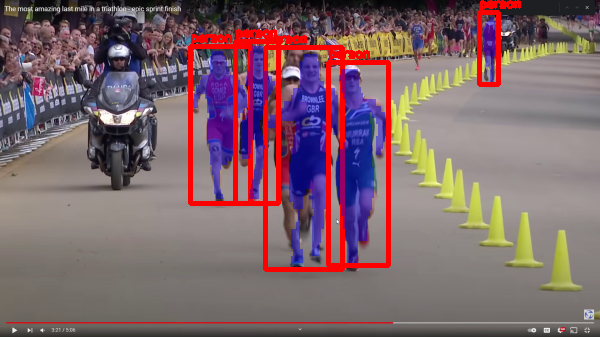

[INFO] elapsed time: 115.06
[INFO] approx. FPS: 0.37


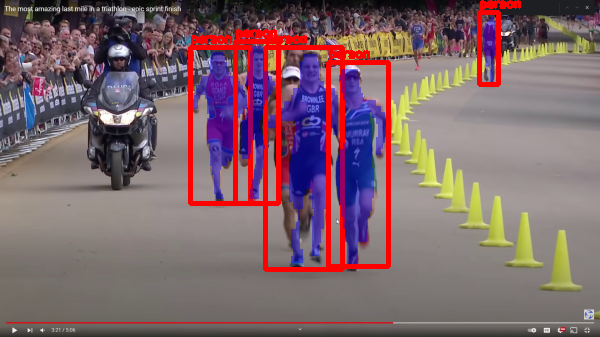

[INFO] elapsed time: 115.29
[INFO] approx. FPS: 0.37


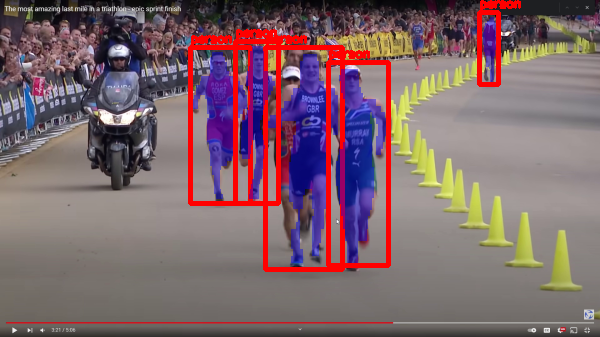

[INFO] elapsed time: 115.59
[INFO] approx. FPS: 0.38


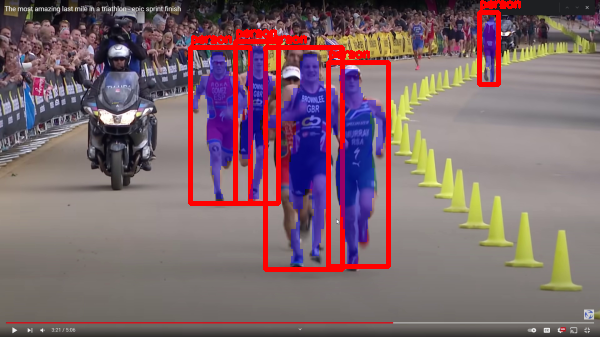

[INFO] elapsed time: 115.84
[INFO] approx. FPS: 0.39


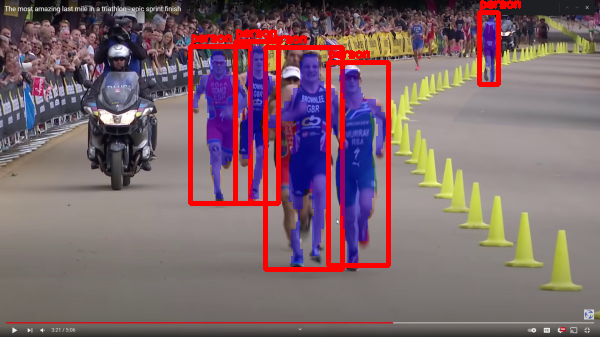

[INFO] elapsed time: 116.08
[INFO] approx. FPS: 0.40


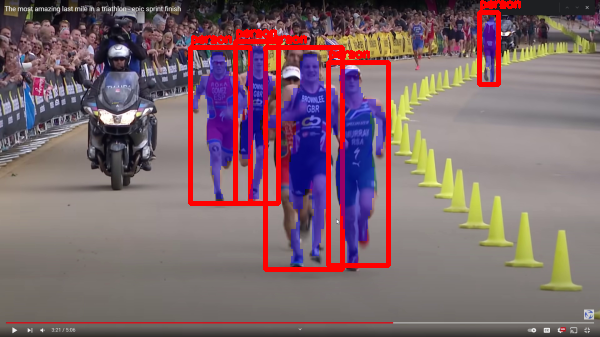

[INFO] elapsed time: 116.33
[INFO] approx. FPS: 0.40


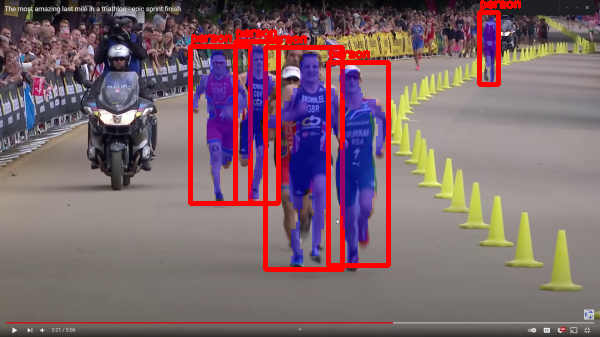

[INFO] elapsed time: 116.66
[INFO] approx. FPS: 0.41


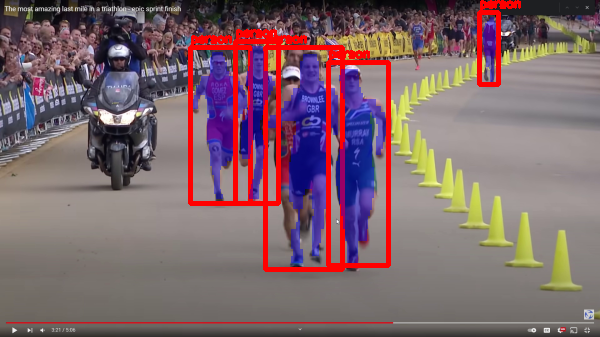

[INFO] elapsed time: 116.91
[INFO] approx. FPS: 0.42


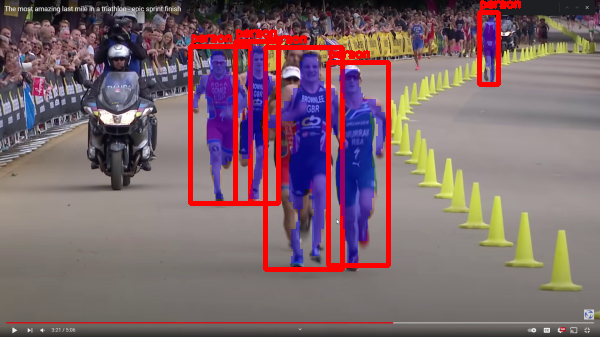

[INFO] elapsed time: 117.18
[INFO] approx. FPS: 0.43


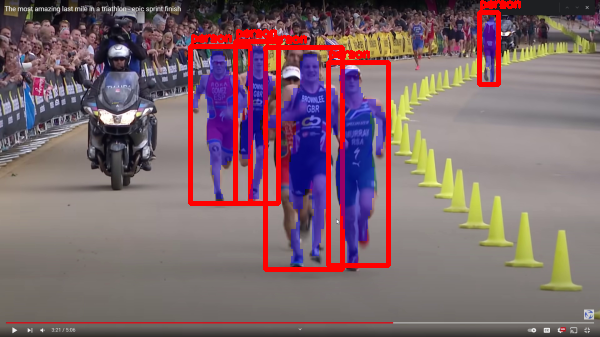

[INFO] elapsed time: 117.41
[INFO] approx. FPS: 0.43


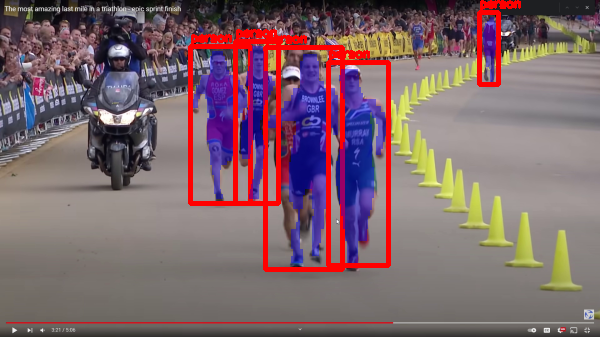

[INFO] elapsed time: 117.66
[INFO] approx. FPS: 0.44


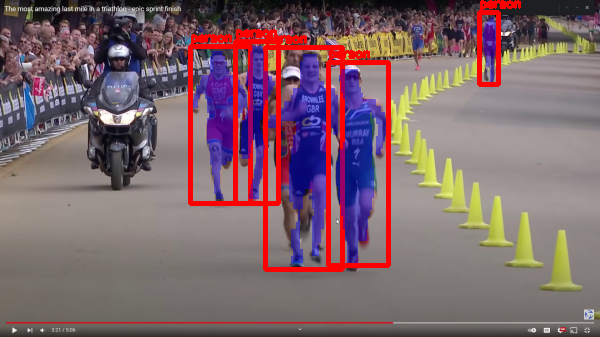

[INFO] elapsed time: 117.91
[INFO] approx. FPS: 0.45


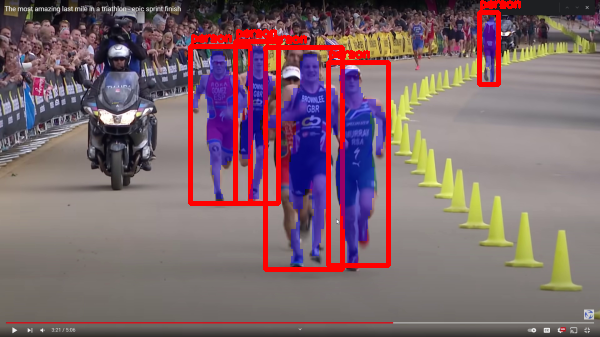

[INFO] elapsed time: 118.18
[INFO] approx. FPS: 0.46


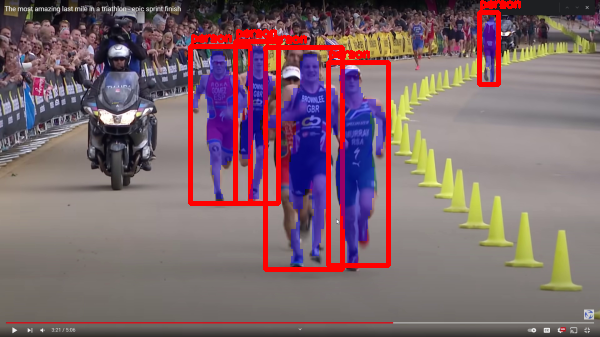

[INFO] elapsed time: 118.53
[INFO] approx. FPS: 0.46


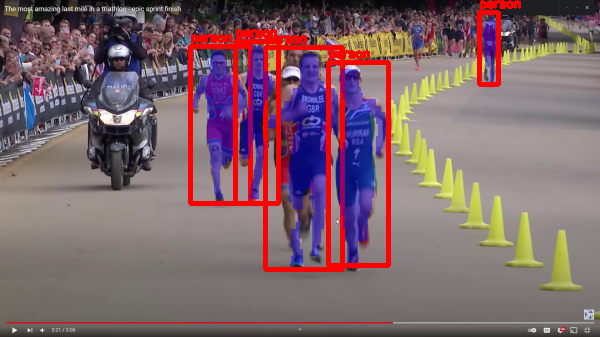

[INFO] elapsed time: 118.79
[INFO] approx. FPS: 0.47


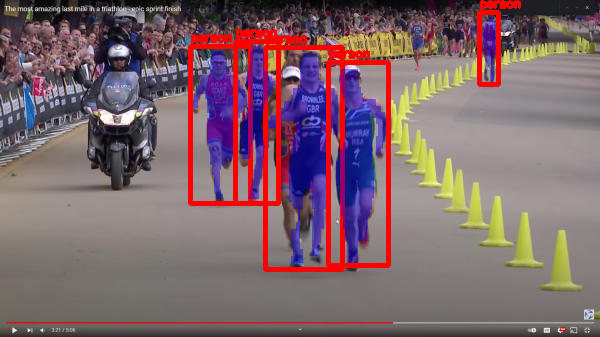

[INFO] elapsed time: 119.02
[INFO] approx. FPS: 0.48


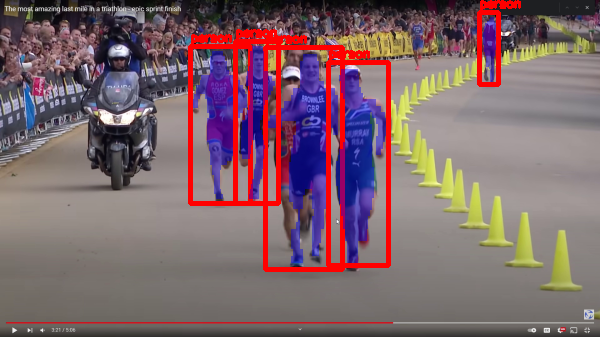

[INFO] elapsed time: 119.30
[INFO] approx. FPS: 0.49


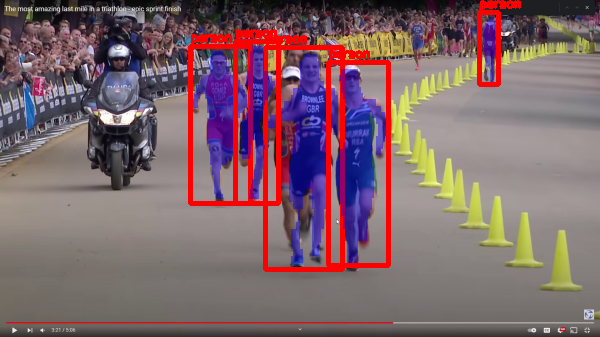

[INFO] elapsed time: 119.53
[INFO] approx. FPS: 0.49


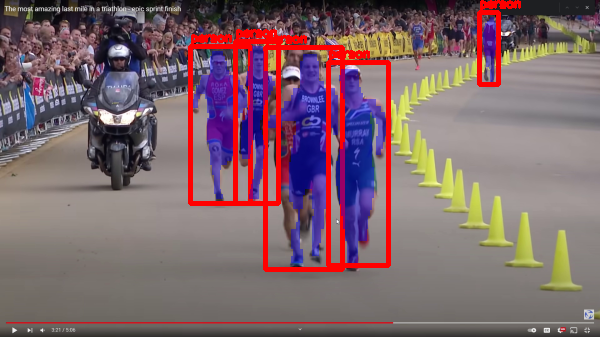

[INFO] elapsed time: 119.79
[INFO] approx. FPS: 0.50


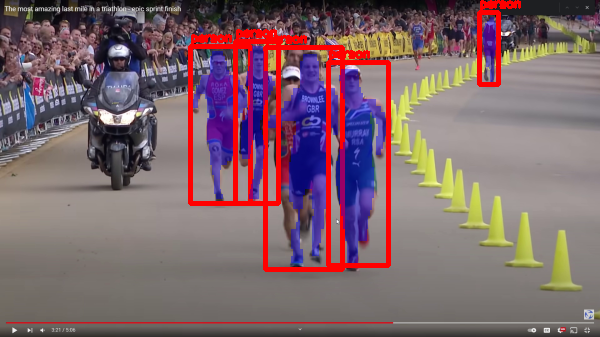

[INFO] elapsed time: 120.10
[INFO] approx. FPS: 0.51


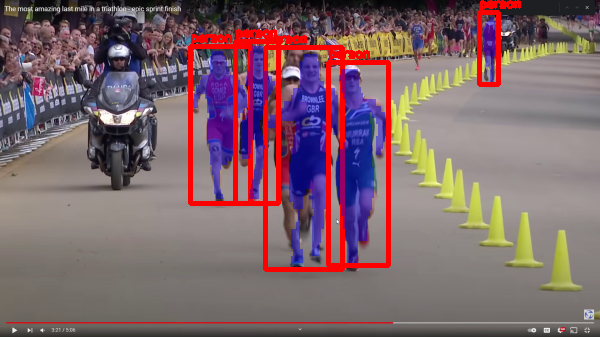

[INFO] elapsed time: 120.36
[INFO] approx. FPS: 0.52


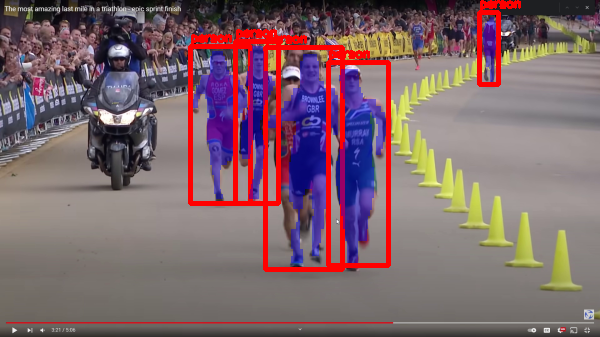

[INFO] elapsed time: 120.59
[INFO] approx. FPS: 0.52


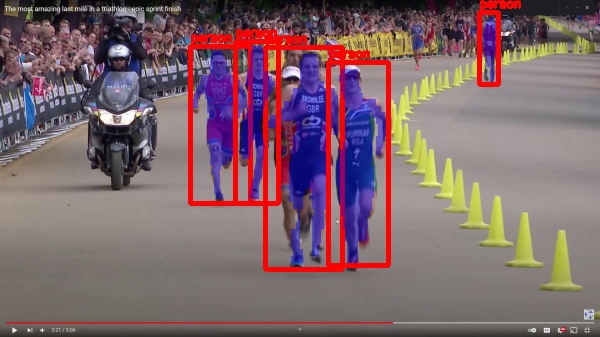

[INFO] elapsed time: 120.85
[INFO] approx. FPS: 0.53


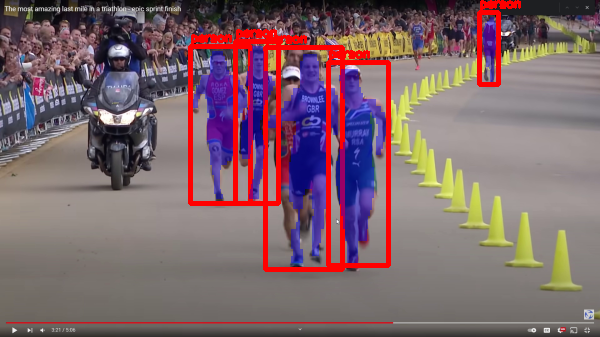

[INFO] elapsed time: 121.11
[INFO] approx. FPS: 0.54


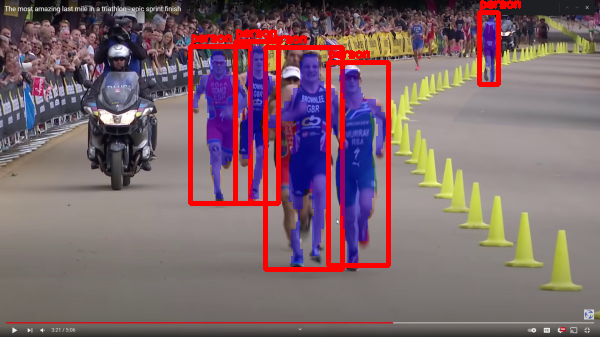

[INFO] elapsed time: 121.37
[INFO] approx. FPS: 0.54


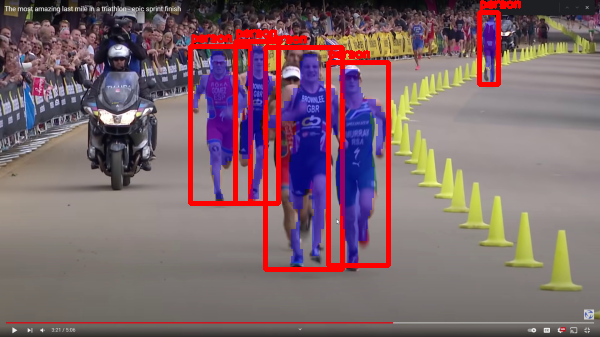

[INFO] elapsed time: 121.66
[INFO] approx. FPS: 0.55


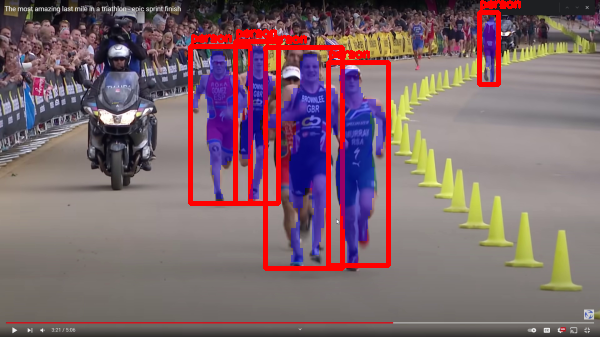

[INFO] elapsed time: 121.94
[INFO] approx. FPS: 0.56


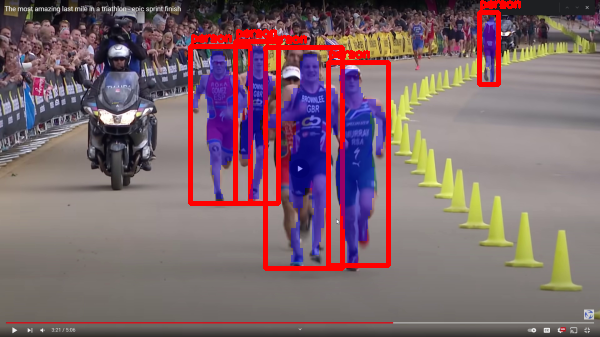

[INFO] elapsed time: 122.19
[INFO] approx. FPS: 0.56


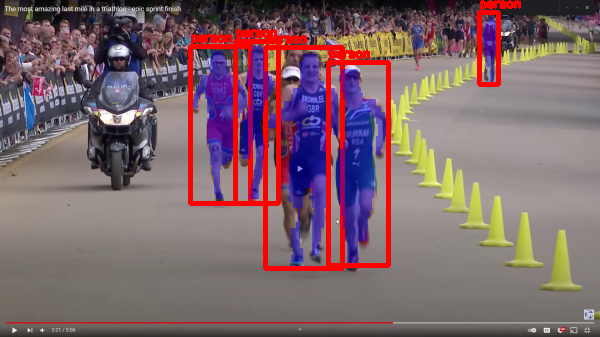

[INFO] elapsed time: 122.46
[INFO] approx. FPS: 0.57


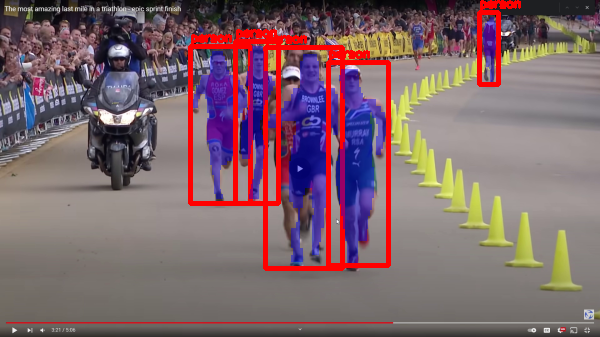

[INFO] elapsed time: 122.70
[INFO] approx. FPS: 0.58


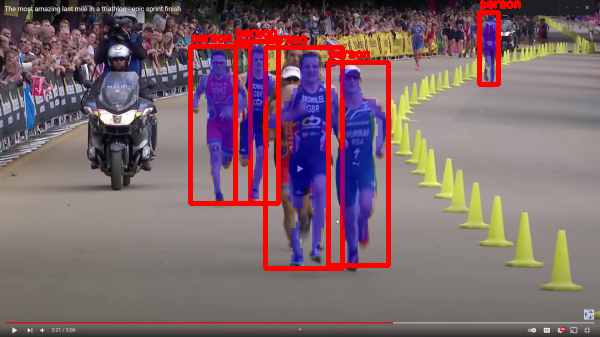

[INFO] elapsed time: 122.96
[INFO] approx. FPS: 0.59


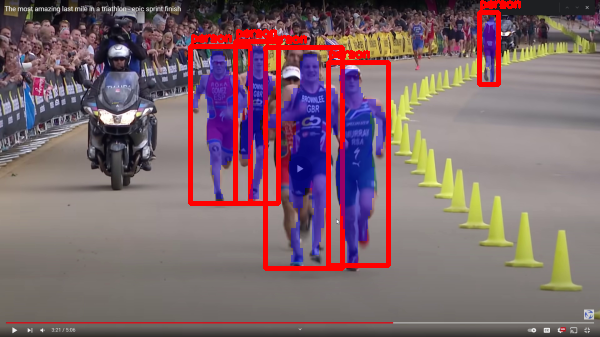

[INFO] elapsed time: 123.22
[INFO] approx. FPS: 0.59


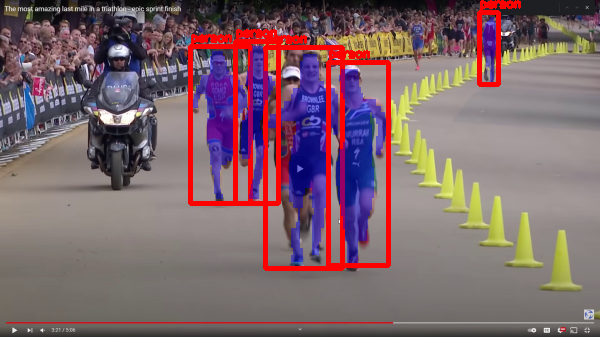

[INFO] elapsed time: 123.51
[INFO] approx. FPS: 0.60


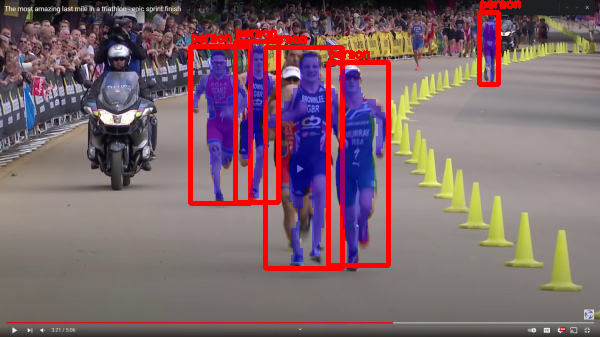

[INFO] elapsed time: 123.75
[INFO] approx. FPS: 0.61


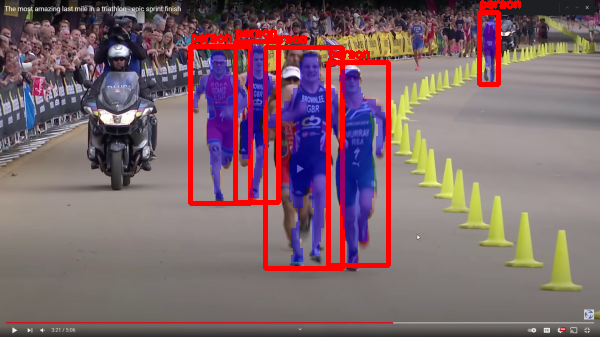

[INFO] elapsed time: 124.02
[INFO] approx. FPS: 0.61


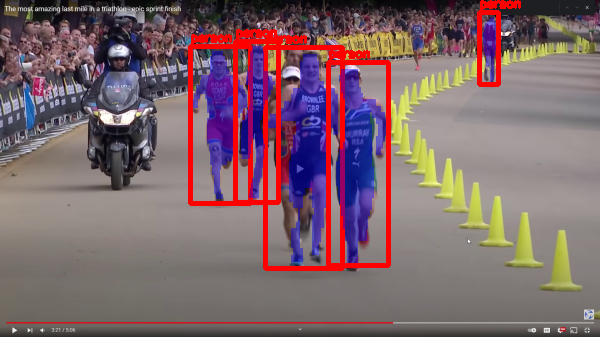

[INFO] elapsed time: 124.25
[INFO] approx. FPS: 0.62


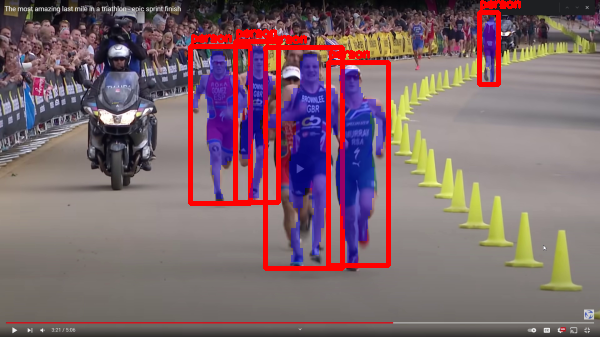

[INFO] elapsed time: 124.51
[INFO] approx. FPS: 0.63


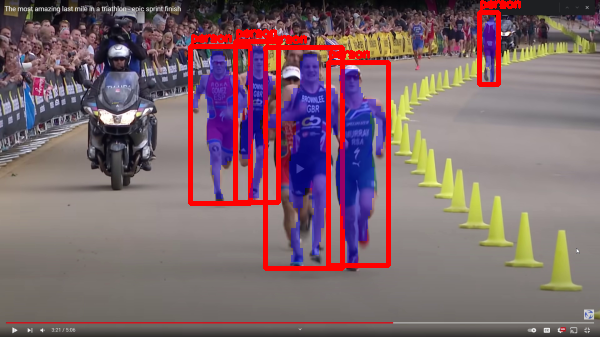

[INFO] elapsed time: 124.81
[INFO] approx. FPS: 0.63


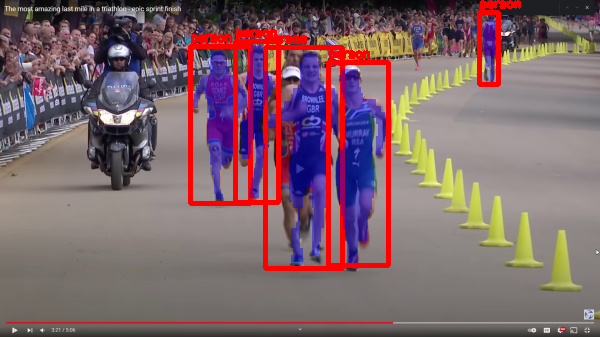

[INFO] elapsed time: 125.09
[INFO] approx. FPS: 0.64


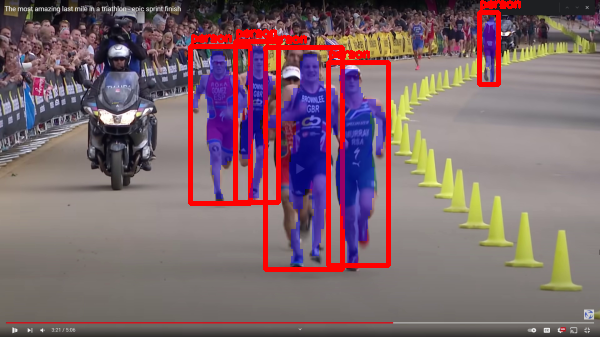

[INFO] elapsed time: 125.34
[INFO] approx. FPS: 0.65


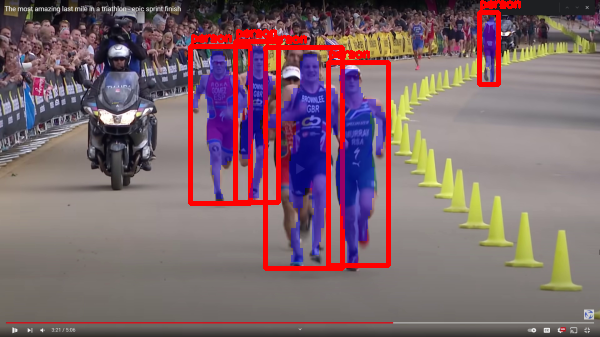

[INFO] elapsed time: 125.60
[INFO] approx. FPS: 0.65


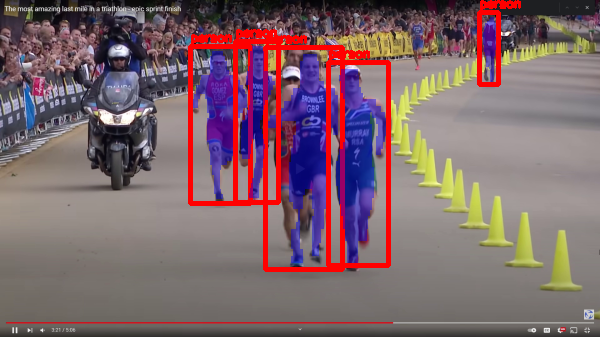

[INFO] elapsed time: 125.84
[INFO] approx. FPS: 0.66


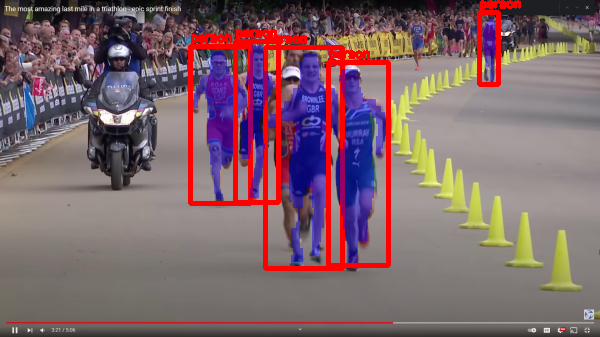

[INFO] elapsed time: 126.12
[INFO] approx. FPS: 0.67


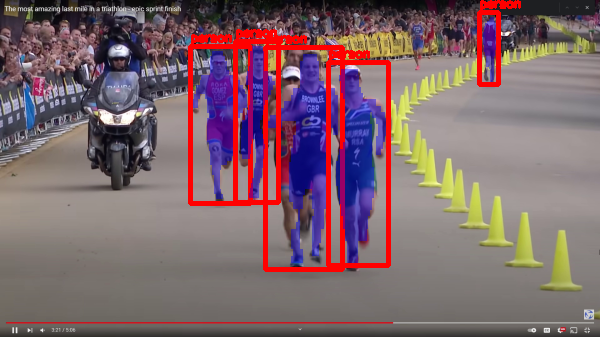

[INFO] elapsed time: 126.43
[INFO] approx. FPS: 0.67


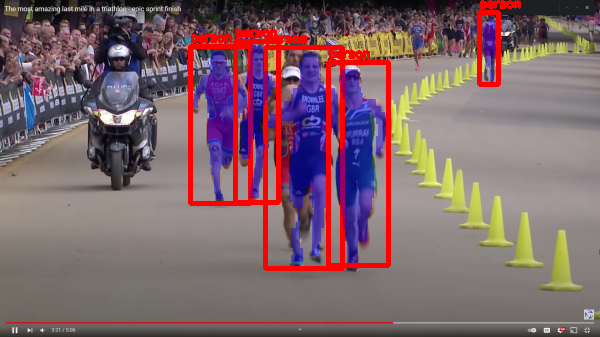

[INFO] elapsed time: 126.71
[INFO] approx. FPS: 0.68


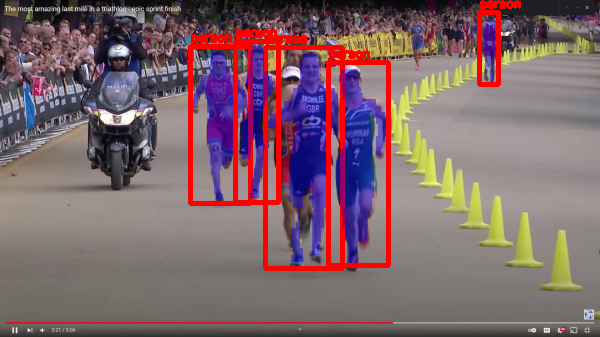

[INFO] elapsed time: 126.95
[INFO] approx. FPS: 0.69


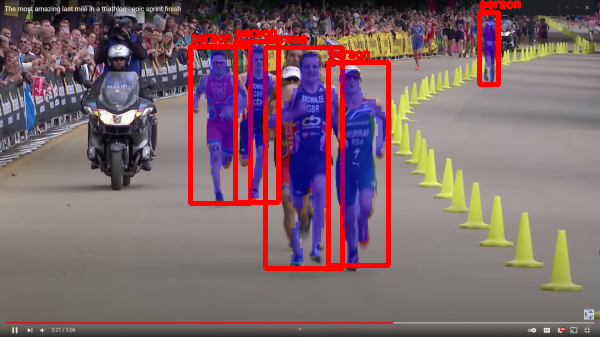

[INFO] elapsed time: 127.22
[INFO] approx. FPS: 0.69


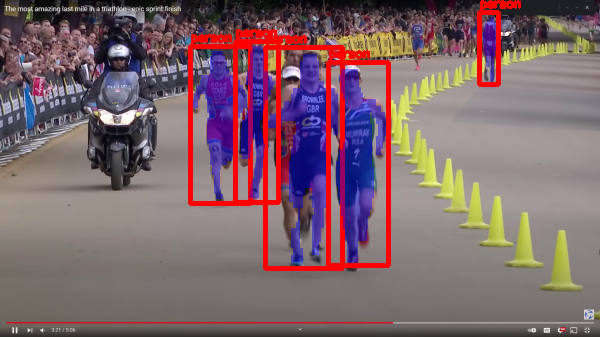

[INFO] elapsed time: 127.46
[INFO] approx. FPS: 0.70


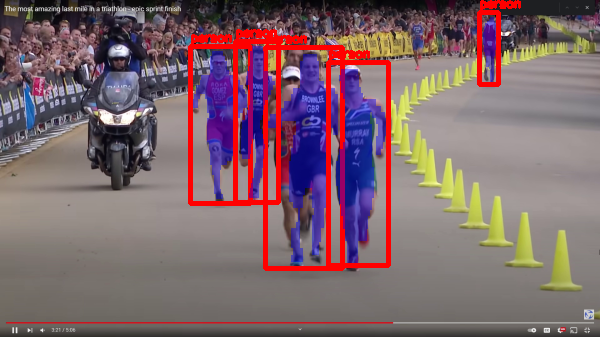

[INFO] elapsed time: 127.77
[INFO] approx. FPS: 0.70


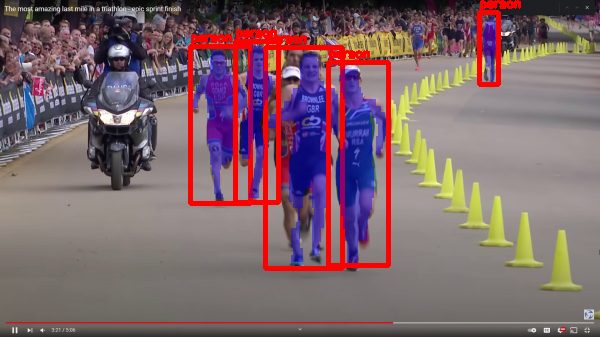

[INFO] elapsed time: 127.99
[INFO] approx. FPS: 0.71


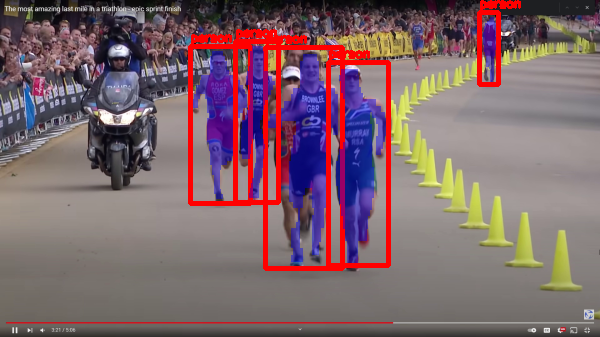

[INFO] elapsed time: 128.27
[INFO] approx. FPS: 0.72


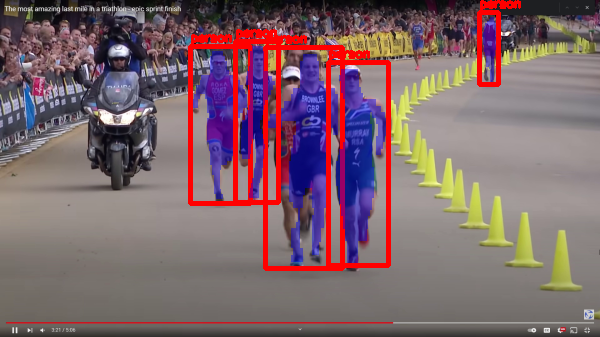

[INFO] elapsed time: 128.50
[INFO] approx. FPS: 0.72


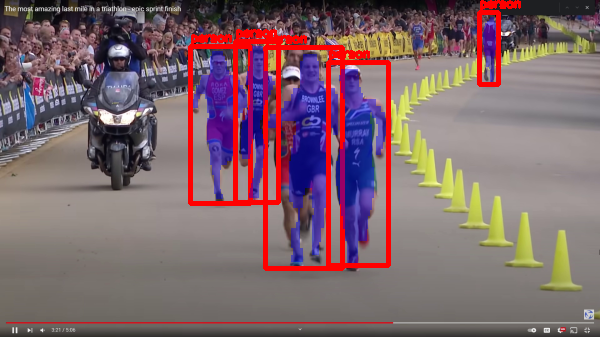

[INFO] elapsed time: 128.76
[INFO] approx. FPS: 0.73


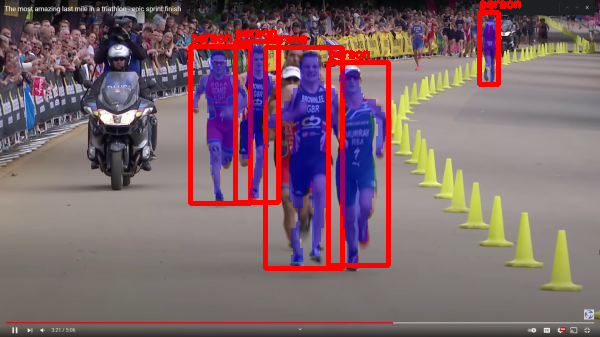

[INFO] elapsed time: 128.98
[INFO] approx. FPS: 0.74


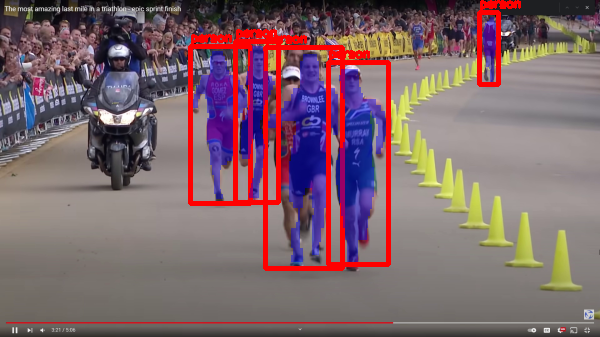

[INFO] elapsed time: 129.28
[INFO] approx. FPS: 0.74


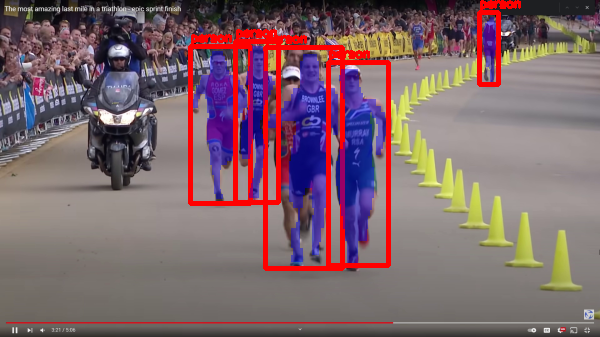

[INFO] elapsed time: 129.52
[INFO] approx. FPS: 0.75


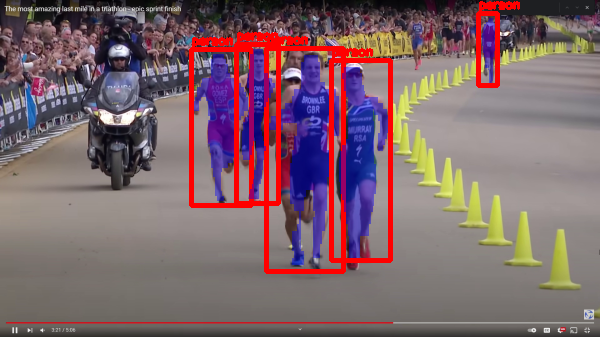

[INFO] elapsed time: 129.80
[INFO] approx. FPS: 0.76


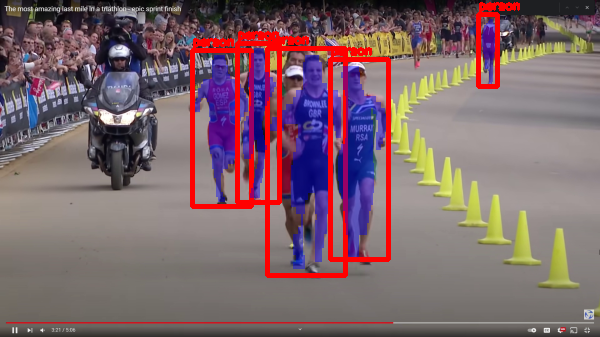

[INFO] elapsed time: 130.04
[INFO] approx. FPS: 0.76


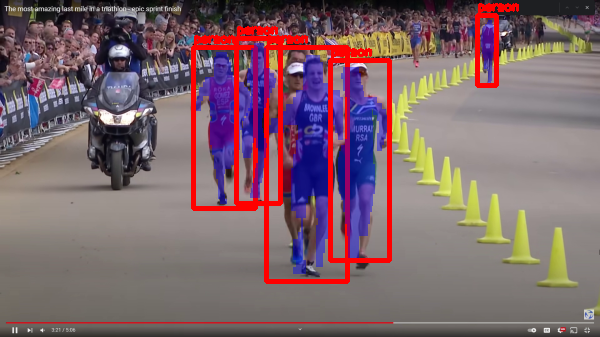

[INFO] elapsed time: 130.33
[INFO] approx. FPS: 0.77


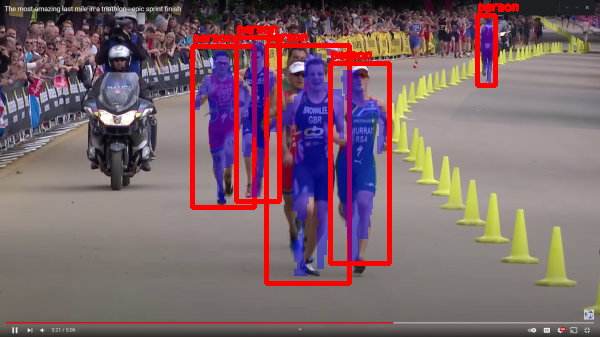

[INFO] elapsed time: 130.63
[INFO] approx. FPS: 0.77


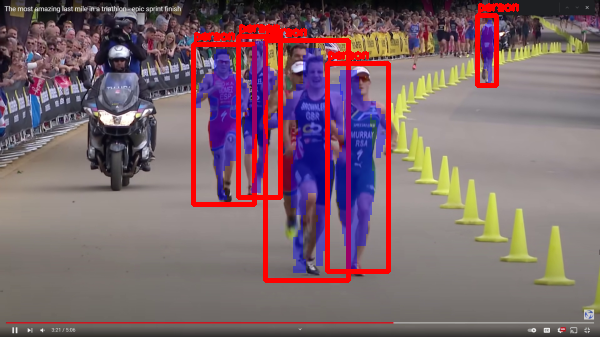

[INFO] elapsed time: 130.89
[INFO] approx. FPS: 0.78


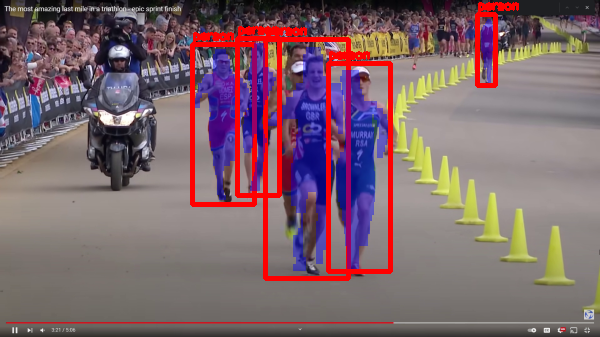

[INFO] elapsed time: 131.15
[INFO] approx. FPS: 0.79


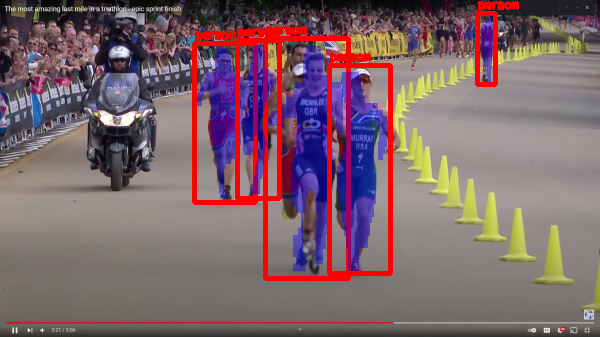

[INFO] elapsed time: 131.40
[INFO] approx. FPS: 0.79


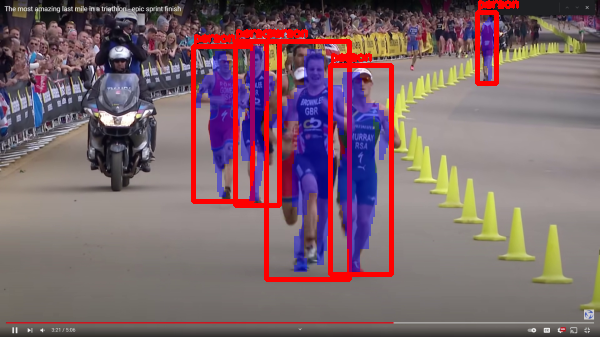

[INFO] elapsed time: 131.68
[INFO] approx. FPS: 0.80


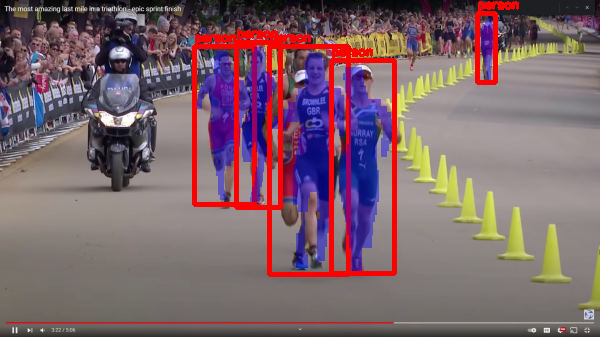

[INFO] elapsed time: 131.99
[INFO] approx. FPS: 0.80


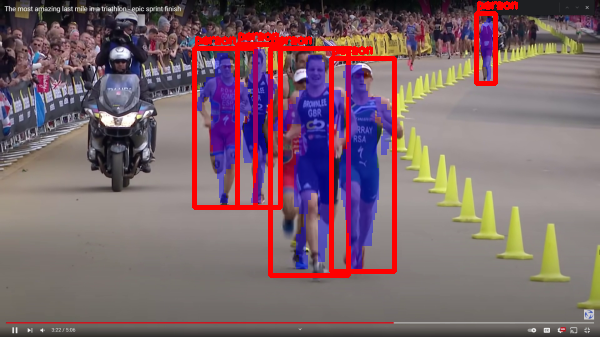

[INFO] elapsed time: 132.26
[INFO] approx. FPS: 0.81


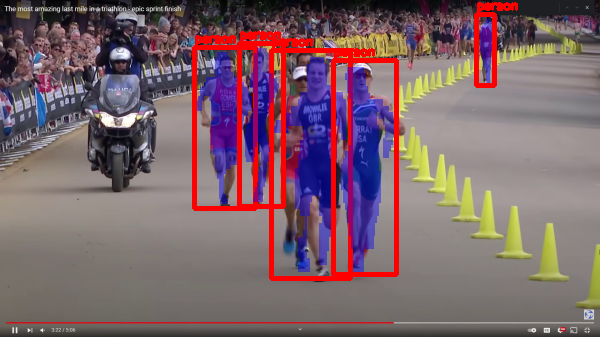

[INFO] elapsed time: 132.51
[INFO] approx. FPS: 0.82


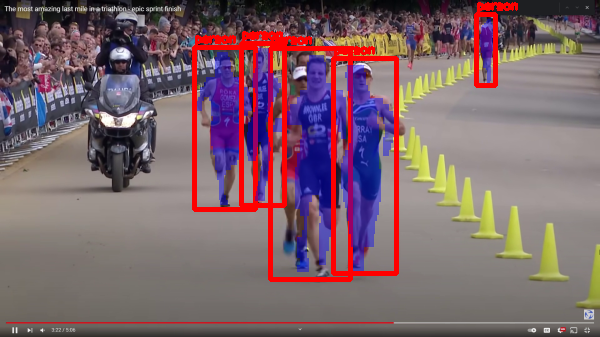

[INFO] elapsed time: 132.79
[INFO] approx. FPS: 0.82


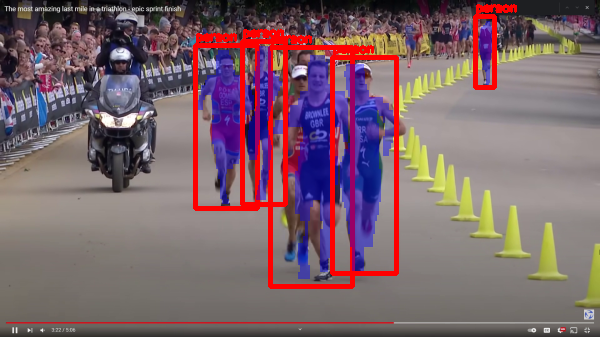

[INFO] elapsed time: 133.10
[INFO] approx. FPS: 0.83


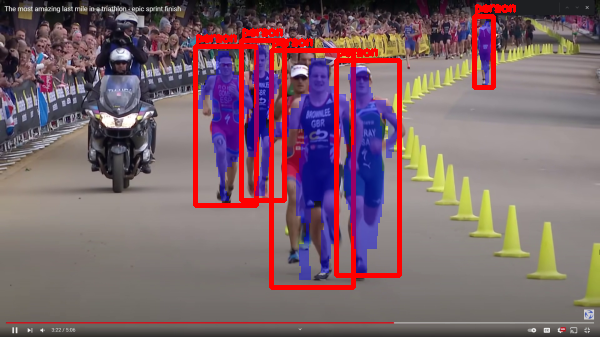

[INFO] elapsed time: 133.36
[INFO] approx. FPS: 0.83


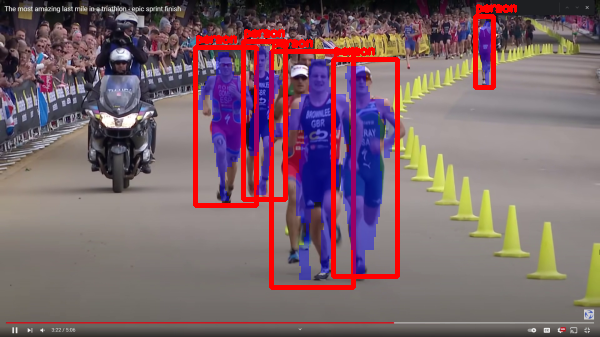

[INFO] elapsed time: 133.65
[INFO] approx. FPS: 0.84


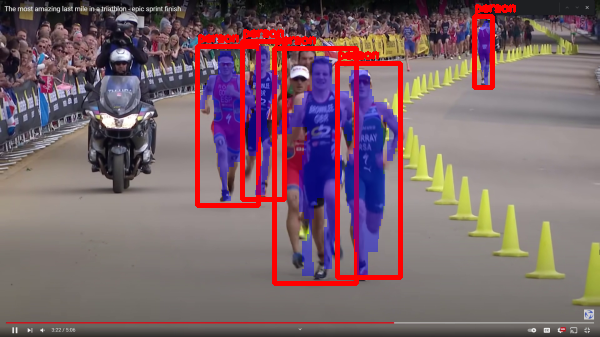

[INFO] elapsed time: 133.92
[INFO] approx. FPS: 0.84


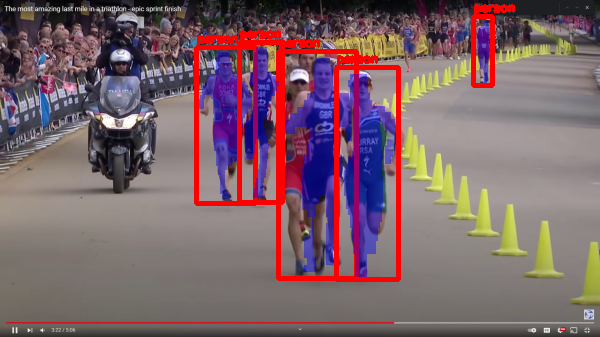

[INFO] elapsed time: 134.19
[INFO] approx. FPS: 0.85


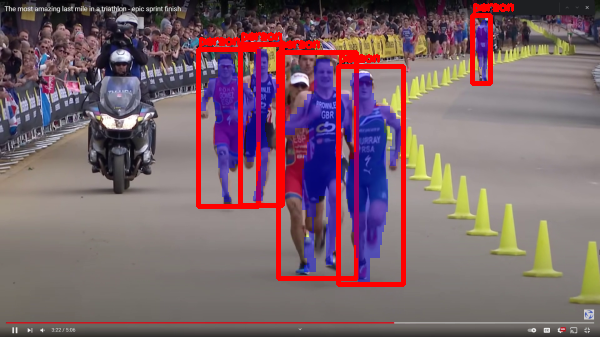

[INFO] elapsed time: 134.49
[INFO] approx. FPS: 0.86


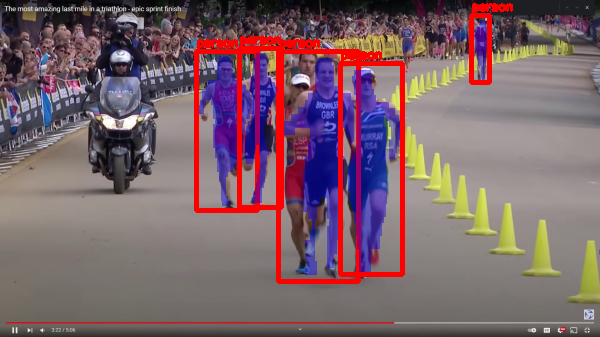

[INFO] elapsed time: 134.81
[INFO] approx. FPS: 0.86


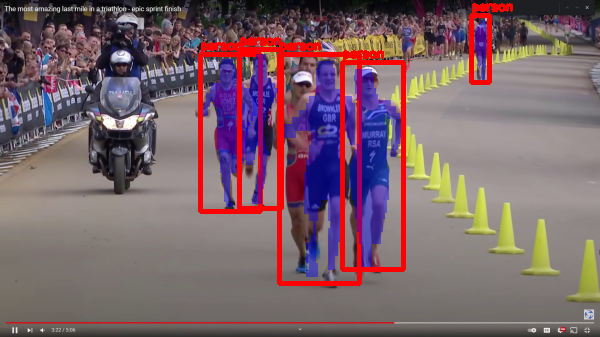

[INFO] elapsed time: 135.08
[INFO] approx. FPS: 0.87


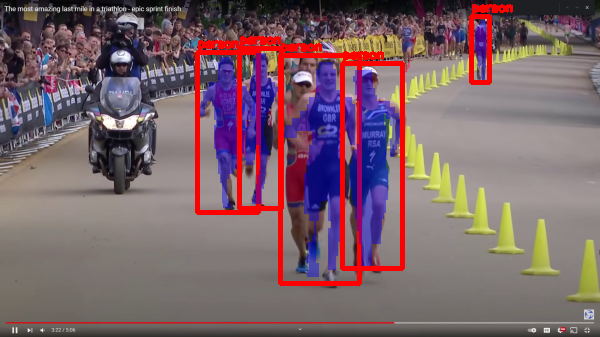

[INFO] elapsed time: 135.35
[INFO] approx. FPS: 0.87


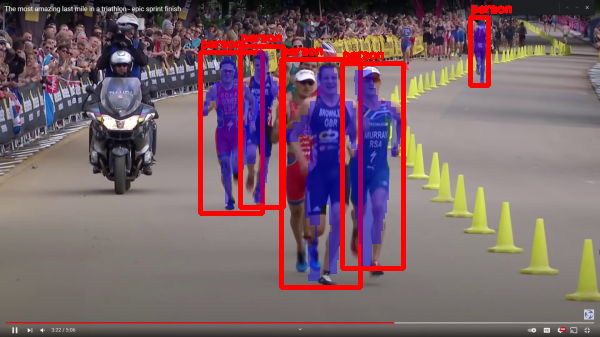

[INFO] elapsed time: 135.62
[INFO] approx. FPS: 0.88


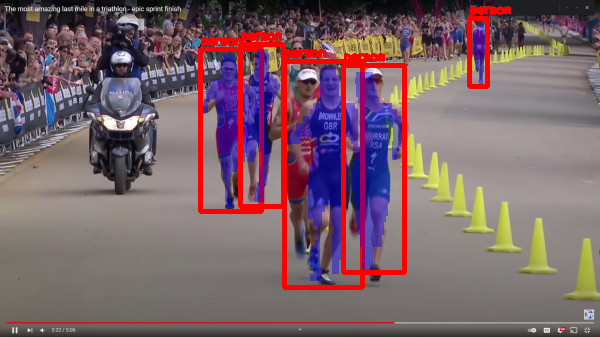

[INFO] elapsed time: 135.89
[INFO] approx. FPS: 0.88


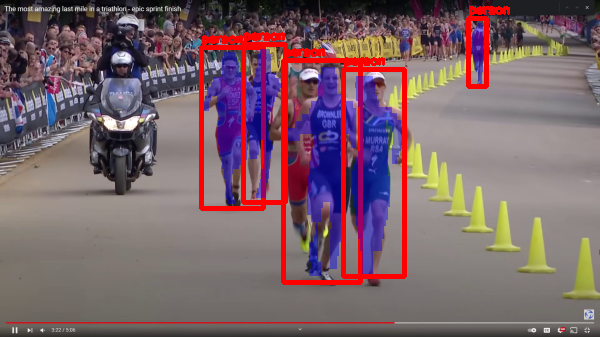

[INFO] elapsed time: 136.19
[INFO] approx. FPS: 0.89


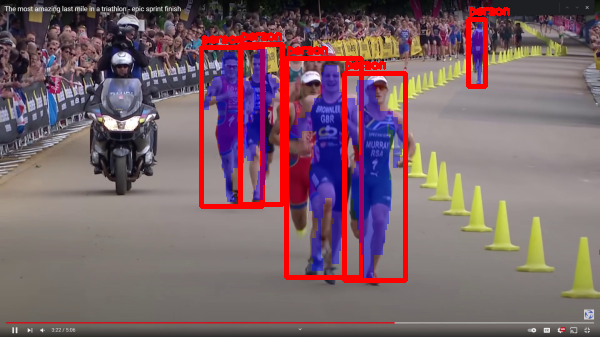

[INFO] elapsed time: 136.49
[INFO] approx. FPS: 0.89


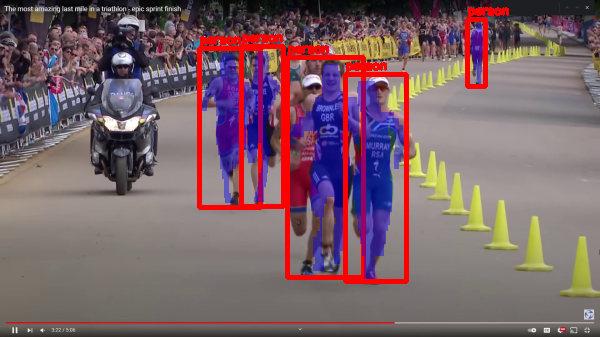

[INFO] elapsed time: 136.75
[INFO] approx. FPS: 0.90


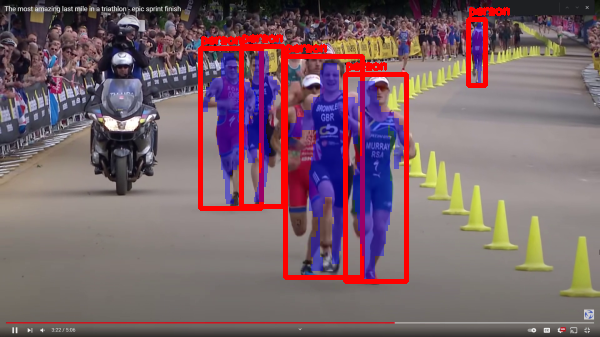

[INFO] elapsed time: 137.03
[INFO] approx. FPS: 0.90


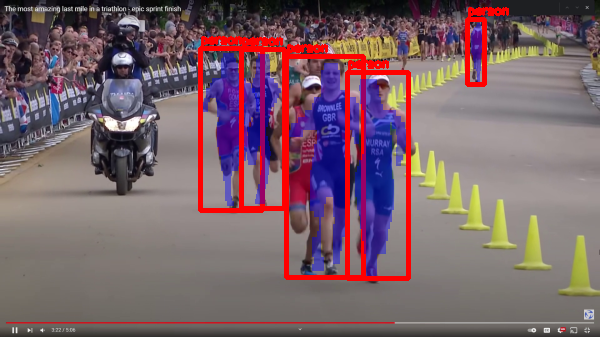

[INFO] elapsed time: 137.29
[INFO] approx. FPS: 0.91


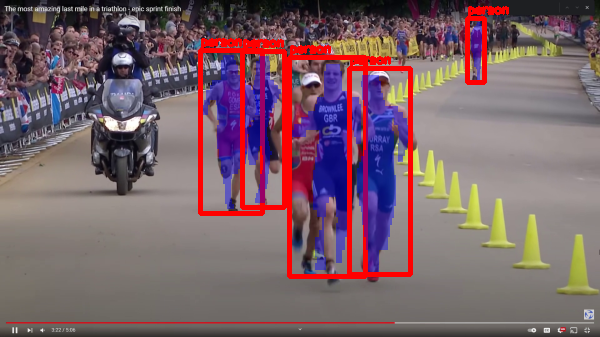

[INFO] elapsed time: 137.58
[INFO] approx. FPS: 0.92


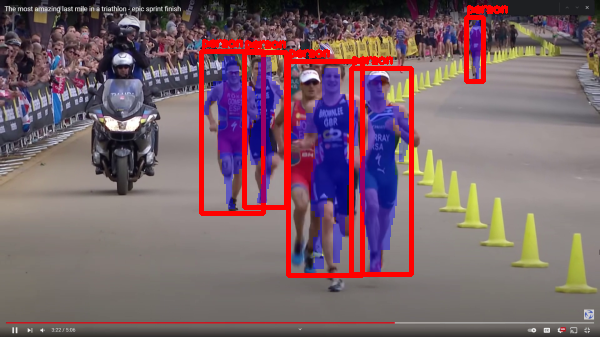

[INFO] elapsed time: 137.85
[INFO] approx. FPS: 0.92


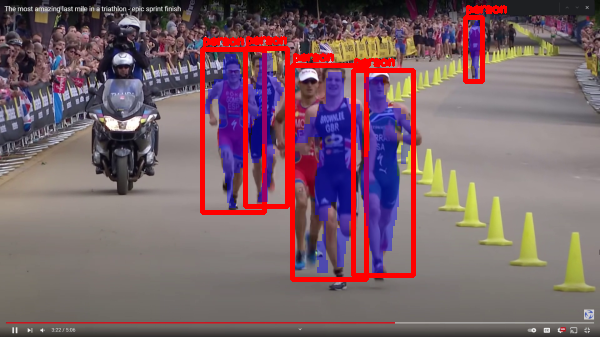

[INFO] elapsed time: 138.13
[INFO] approx. FPS: 0.93


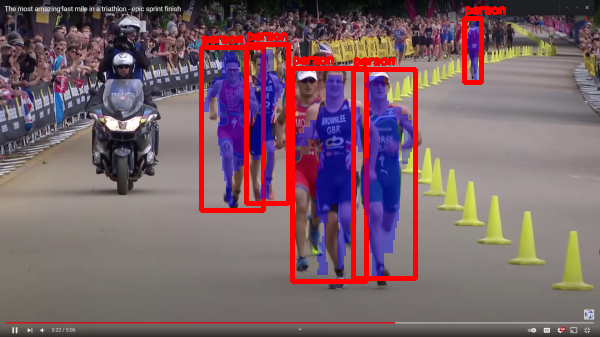

[INFO] elapsed time: 138.36
[INFO] approx. FPS: 0.93


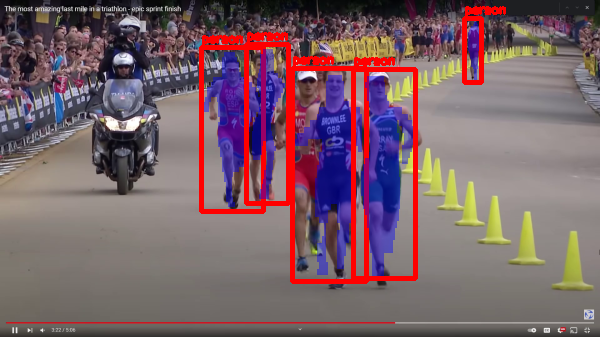

[INFO] elapsed time: 138.62
[INFO] approx. FPS: 0.94


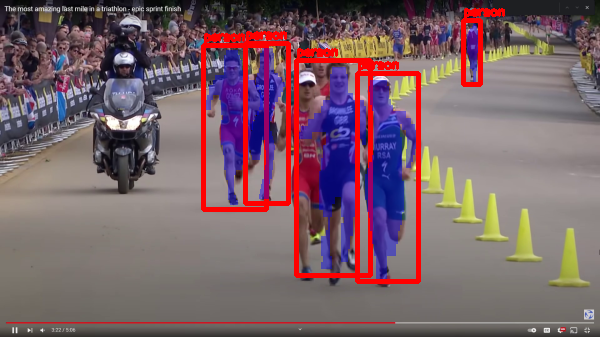

[INFO] elapsed time: 138.91
[INFO] approx. FPS: 0.94


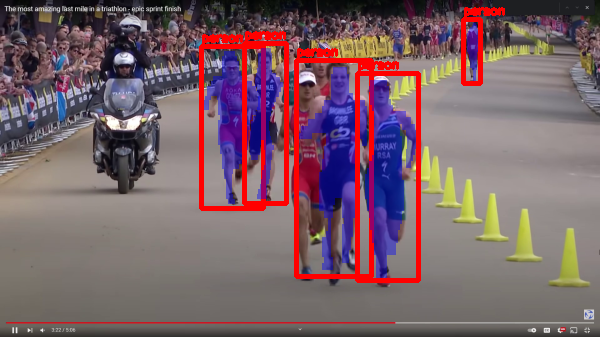

[INFO] elapsed time: 139.18
[INFO] approx. FPS: 0.95


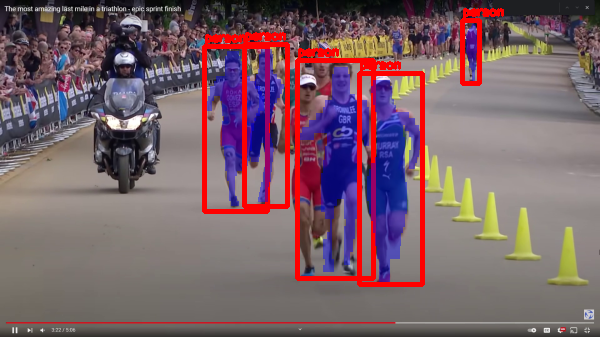

[INFO] elapsed time: 139.46
[INFO] approx. FPS: 0.95


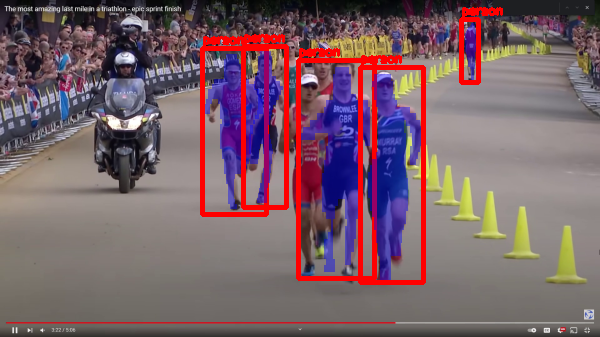

[INFO] elapsed time: 139.73
[INFO] approx. FPS: 0.96


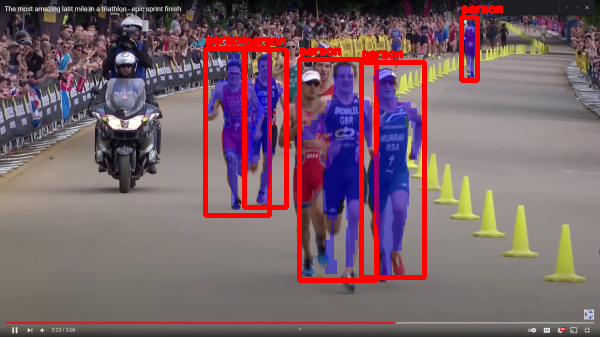

[INFO] elapsed time: 140.00
[INFO] approx. FPS: 0.96


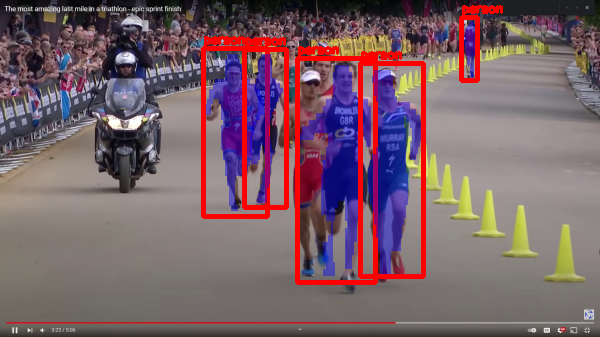

[INFO] elapsed time: 140.33
[INFO] approx. FPS: 0.97


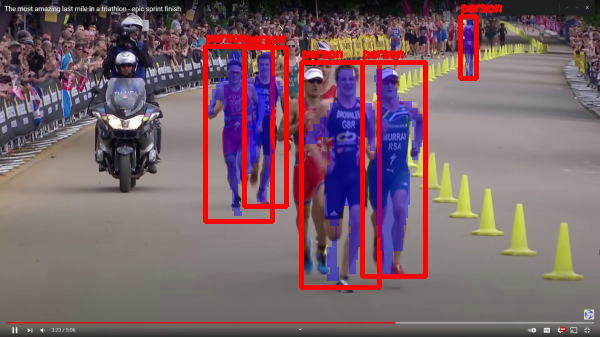

[INFO] elapsed time: 140.61
[INFO] approx. FPS: 0.97


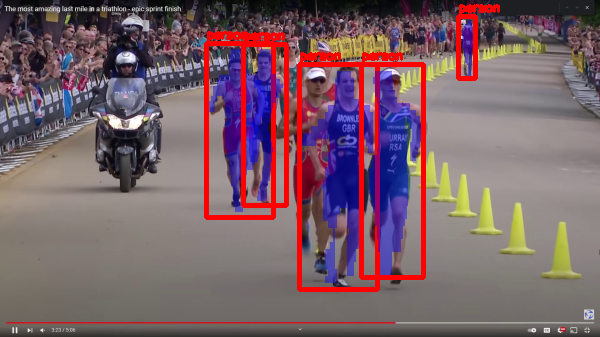

[INFO] elapsed time: 140.87
[INFO] approx. FPS: 0.98


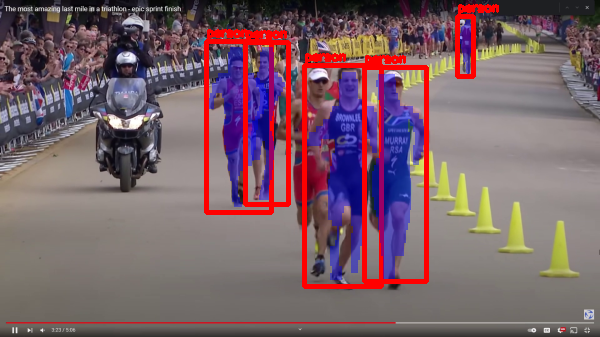

[INFO] elapsed time: 141.14
[INFO] approx. FPS: 0.98


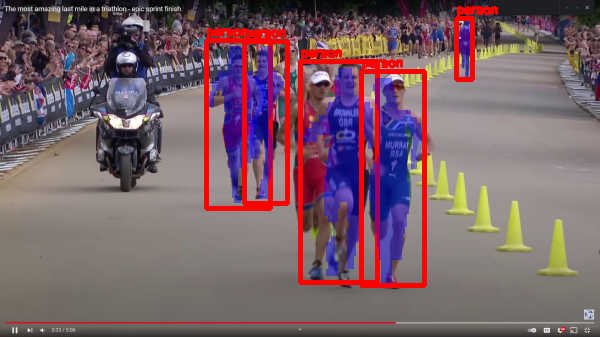

[INFO] elapsed time: 141.39
[INFO] approx. FPS: 0.99


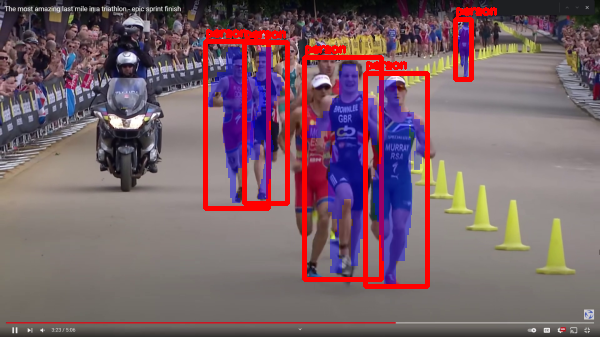

[INFO] elapsed time: 141.65
[INFO] approx. FPS: 1.00


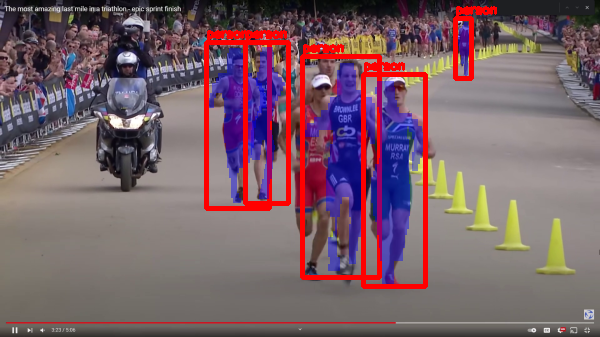

[INFO] elapsed time: 141.98
[INFO] approx. FPS: 1.00


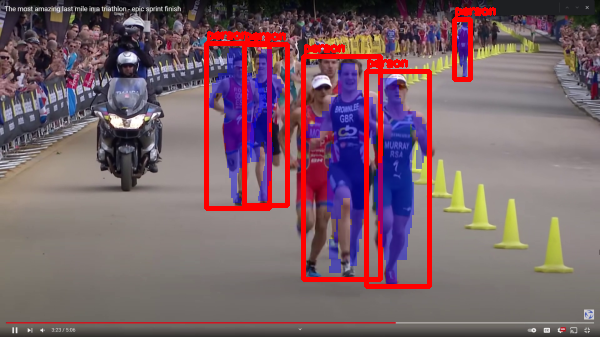

[INFO] elapsed time: 142.24
[INFO] approx. FPS: 1.01


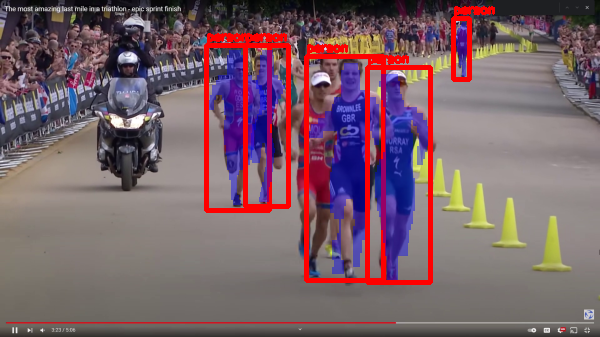

[INFO] elapsed time: 142.50
[INFO] approx. FPS: 1.01


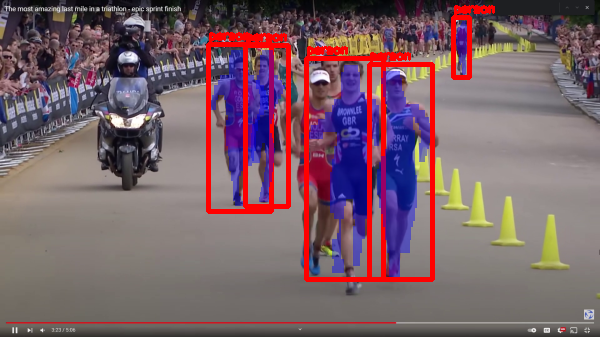

[INFO] elapsed time: 142.77
[INFO] approx. FPS: 1.02


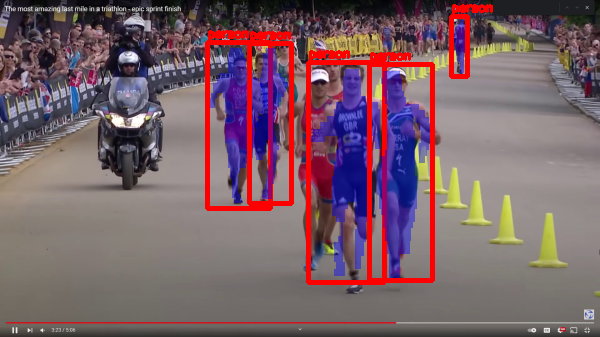

[INFO] elapsed time: 143.03
[INFO] approx. FPS: 1.02


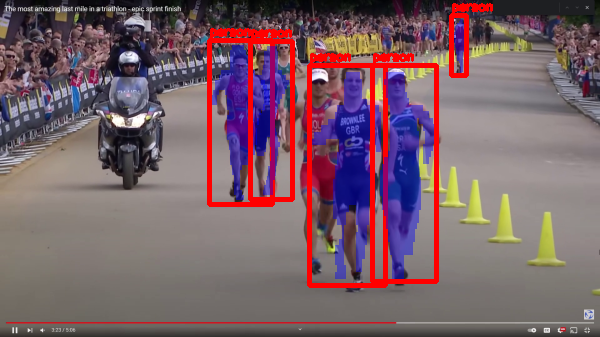

[INFO] elapsed time: 143.29
[INFO] approx. FPS: 1.03


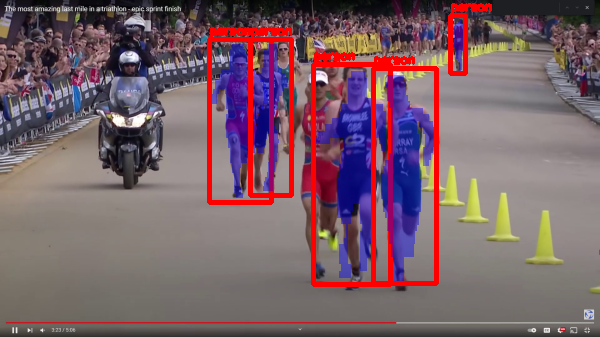

[INFO] elapsed time: 143.58
[INFO] approx. FPS: 1.03


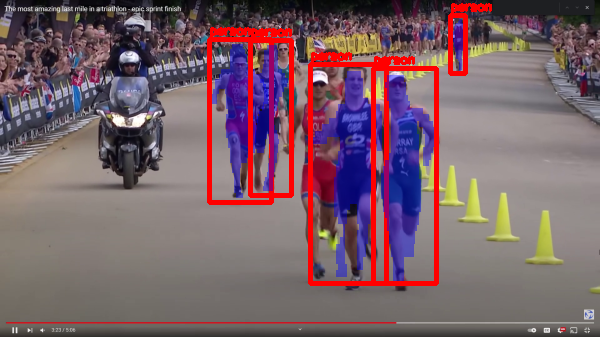

[INFO] elapsed time: 143.85
[INFO] approx. FPS: 1.04


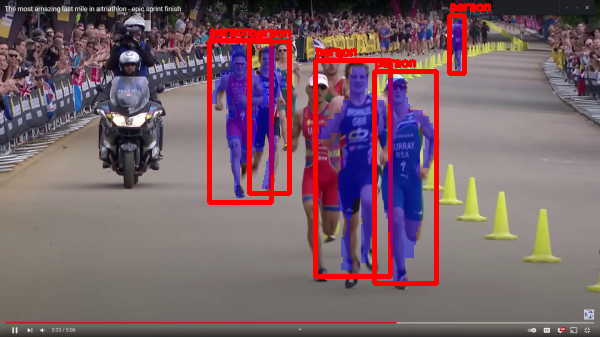

[INFO] elapsed time: 144.12
[INFO] approx. FPS: 1.04


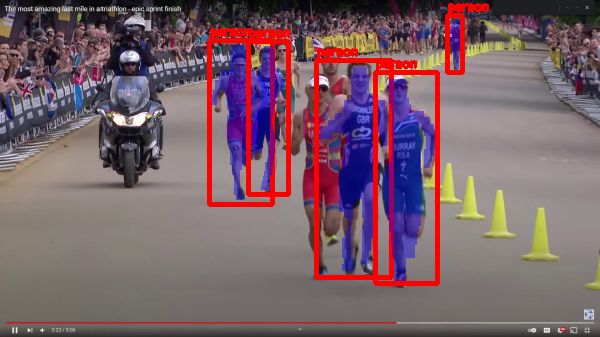

[INFO] elapsed time: 144.39
[INFO] approx. FPS: 1.05


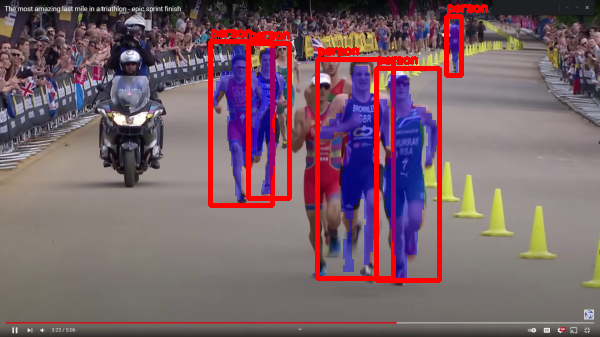

[INFO] elapsed time: 144.63
[INFO] approx. FPS: 1.05


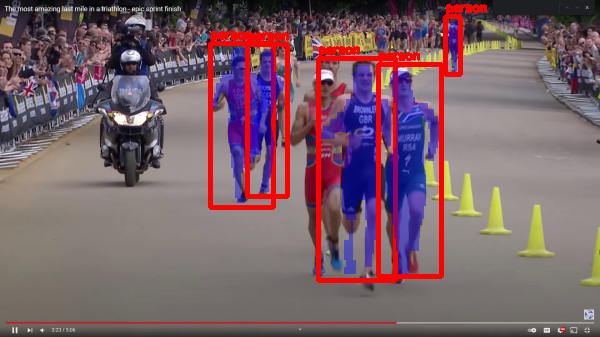

[INFO] elapsed time: 144.88
[INFO] approx. FPS: 1.06


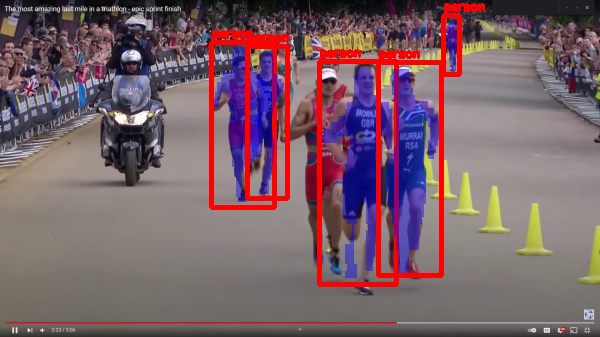

[INFO] elapsed time: 145.14
[INFO] approx. FPS: 1.06


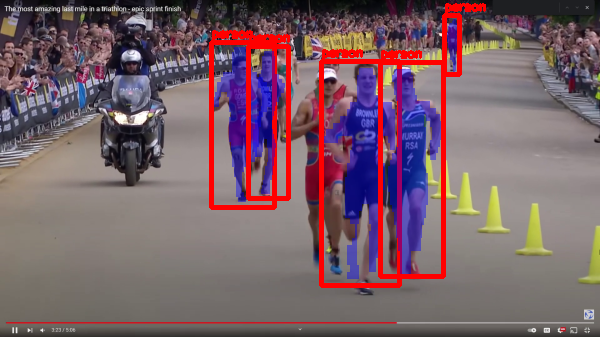

[INFO] elapsed time: 145.43
[INFO] approx. FPS: 1.07


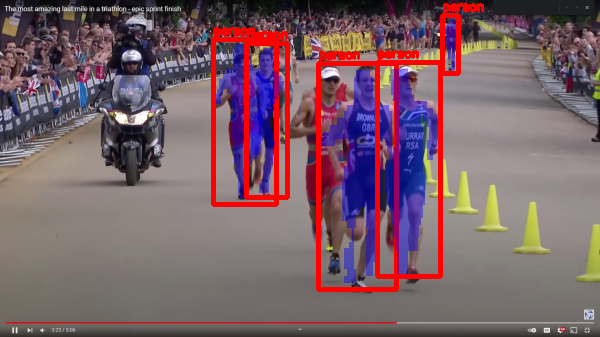

[INFO] elapsed time: 145.69
[INFO] approx. FPS: 1.07


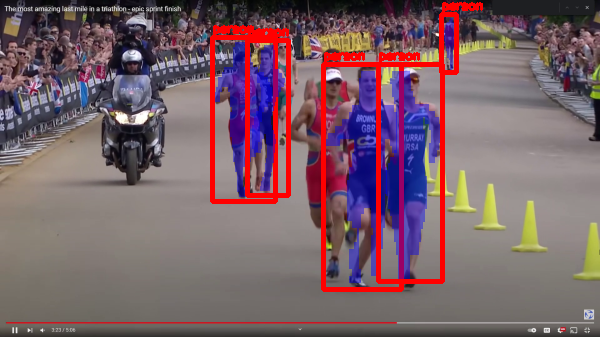

[INFO] elapsed time: 145.97
[INFO] approx. FPS: 1.08


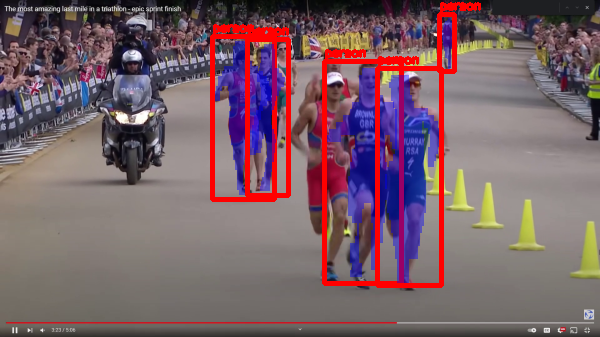

[INFO] elapsed time: 146.22
[INFO] approx. FPS: 1.08


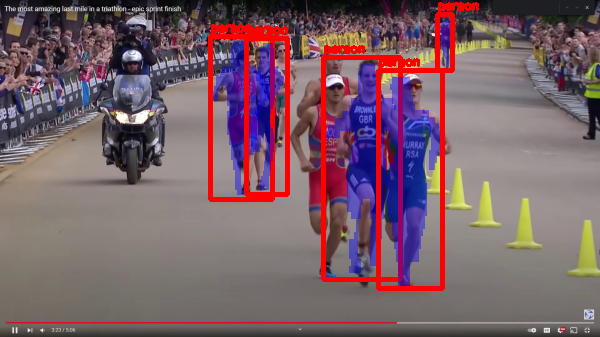

[INFO] elapsed time: 146.51
[INFO] approx. FPS: 1.09


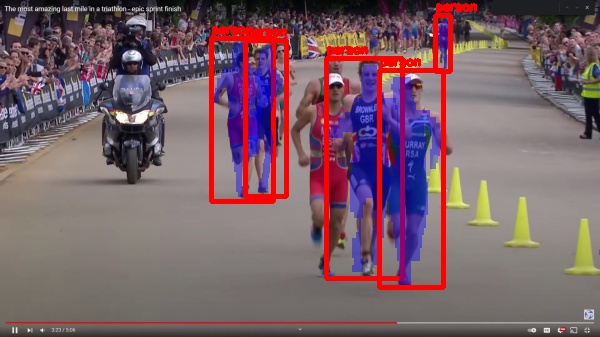

[INFO] elapsed time: 146.79
[INFO] approx. FPS: 1.09


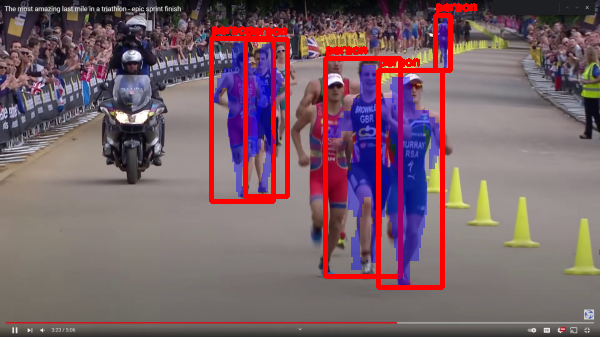

[INFO] elapsed time: 147.08
[INFO] approx. FPS: 1.09


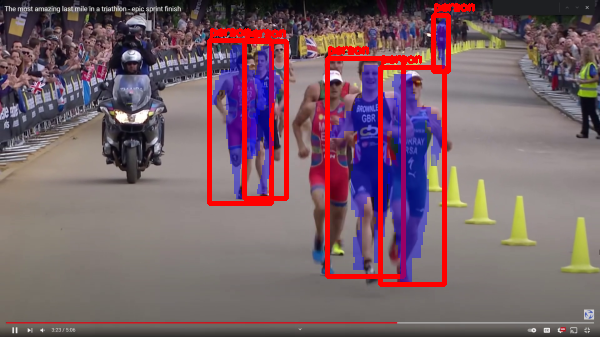

[INFO] elapsed time: 147.36
[INFO] approx. FPS: 1.10


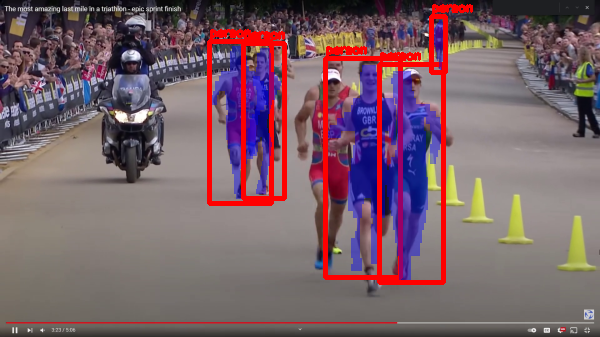

[INFO] elapsed time: 147.62
[INFO] approx. FPS: 1.10


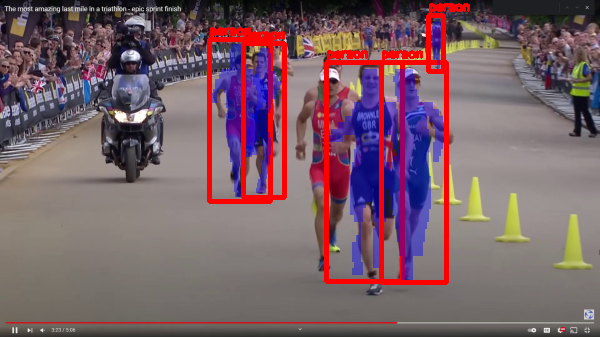

[INFO] elapsed time: 147.87
[INFO] approx. FPS: 1.11


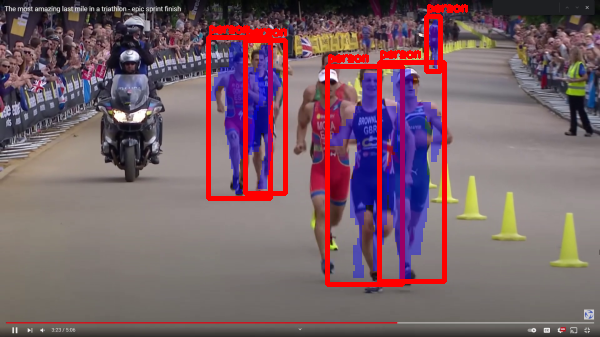

[INFO] elapsed time: 148.11
[INFO] approx. FPS: 1.11


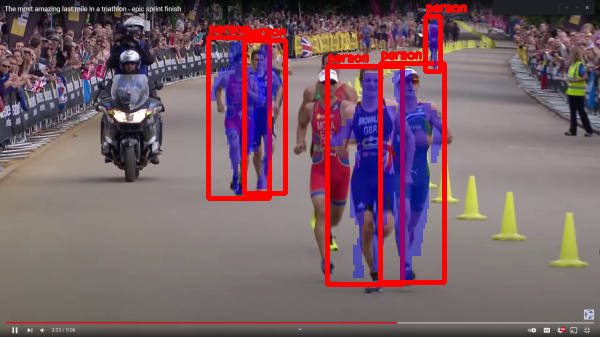

[INFO] elapsed time: 148.40
[INFO] approx. FPS: 1.12


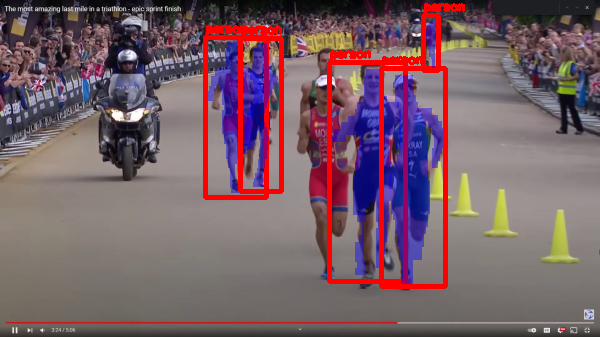

[INFO] elapsed time: 148.66
[INFO] approx. FPS: 1.12


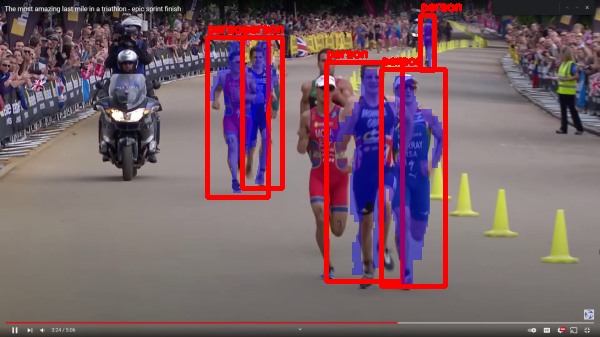

In [ ]:
# loop over frames from the video file stream
while True:
  # read the next frame from the file
  (grabbed, frame) = vs.read()

  # if the frame was not grabbed, then we have reached the end
  # of the stream
  if not grabbed:
    break

  # resize the frame to have a maximum width of 400 pixels
  frame = imutils.resize(frame, width=600) 
  rgb = cv2.cvtColor(frame,cv2.COLOR_BGR2RGB)

  # converting to tensors for inserting into model
  image_tensor = tf.convert_to_tensor(rgb , dtype=tf.uint8)
  image_tensor = tf.expand_dims(image_tensor, axis=0)
  image_tensor

  if len(trackers) == 0:
    
    start = time.time()
    # making predictions
    detector_output = detector(image_tensor)
    end = time.time()

    # fetching outputs
    classes = detector_output["detection_classes"][0].numpy().astype(int)
    masks = detector_output["detection_masks"][0].numpy()
    boxes = detector_output["detection_boxes"][0].numpy()
    scores = detector_output["detection_scores"][0].numpy()

    # processing output and plotting bounding boxes and masks
    
    (H,W) = rgb.shape[:2]

    for score, (ymin,xmin,ymax,xmax), label, mask in zip(scores,boxes,classes,masks):

      if score >0.8:

        if label!=1:
          continue

        (ymin,xmin,ymax,xmax) = ((ymin,xmin,ymax,xmax)*np.array([H,W,H,W])).astype(int)

        mask = (mask*255).astype("uint8")

        # start tracking

        t = dlib.correlation_tracker()
        rect = dlib.rectangle(xmin,ymin,xmax,ymax)
        t.start_track(rgb, rect)

        # update our set of trackers and corresponding class
        # labels
        labels.append(label)
        trackers.append(t)
        mask_list.append(mask)
          

        # image segmentation - masks

        roi = frame[ymin:ymax,xmin:xmax]
        # shoe_crop =roi.copy()
        # print(roi.shape)

        roi_height = ymax - ymin
        roi_width = xmax - xmin

        # Resizing mask to size of ROI 
        mask_fetch = cv2.resize(mask,(roi_width, roi_height),interpolation=cv2.INTER_NEAREST)
        # instance = cv2.bitwise_and(roi,roi,mask=mask_fetch)

        # 70% threshold for predicted value of each pixel
        masking = (mask_fetch > threshold)
               

        # blending mask with ROI
        roi_mask = roi[masking]
        blend = ((0.4* (np.array([255,0,0]).astype(int))) + (0.6*roi_mask)).astype("uint8")

        frame[ymin:ymax,xmin:xmax][masking] = blend

        # object detection - boxes
        img = cv2.rectangle(frame , (xmin,ymin), (xmax,ymax), (0,0,255),3)
        # text = "{}: - {:.4f}".format(LABELS[label],score)
        img = cv2.putText( img, LABELS[label], (xmin,ymin-5),cv2.FONT_HERSHEY_SIMPLEX, 0.40, (0,0,255),2)

        
    
      # cropping picture of shoes from mask

      # shoes = cv2.bitwise_and(shoe_crop[200:,:],shoe_crop[200:,:],mask=mask_fetch[200:,:])
      # shoes = cv2.resize(shoes,(800,800))
      # print("resized shoe picture :",shoes.shape)
      # plt.imshow(shoes)
      # plt.show()

  else:

    
    for (t, l, mask) in zip(trackers, labels,mask_list):
      # update the tracker and grab the position of the tracked
      # object
      t.update(rgb)
      pos = t.get_position()

      # unpack the position object
      xmin = int(pos.left())
      ymin = int(pos.top())
      xmax = int(pos.right())
      ymax = int(pos.bottom())
      
      # image segmentation - masks

      roi = frame[ymin:ymax,xmin:xmax]
      # shoe_crop =roi.copy()
      # print(roi.shape)

      roi_height = ymax - ymin
      roi_width = xmax - xmin

      # Resizing mask to size of ROI 
      mask1 = cv2.resize(mask,(roi_width, roi_height), interpolation=cv2.INTER_NEAREST)
      # instance = cv2.bitwise_and(roi,roi,mask=mask_fetch)

      # 70% threshold for predicted value of each pixel
      mask_bol = (mask1 > threshold)
              

      # blending mask with ROI
      roi_mask1 = roi[mask_bol]
      blend1 = ((0.4* (np.array([255,0,0]).astype(int))) + (0.6*roi_mask1)).astype("uint8")

      frame[ymin:ymax,xmin:xmax][mask_bol] = blend1

      # object detection - boxes
      img = cv2.rectangle(frame , (xmin,ymin), (xmax,ymax), (0,0,255),3)
      # text = "{}: - {:.4f}".format(LABELS[label],score)
      img = cv2.putText( img, LABELS[label], (xmin,ymin-5),cv2.FONT_HERSHEY_SIMPLEX, 0.40, (0,0,255),2)
  

  if writer is None:
    # initialize our video writer
    fourcc = cv2.VideoWriter_fourcc(*"MJPG")
    writer = cv2.VideoWriter('/content/Mask-RCNN/output3.avi', fourcc, 30,(frame.shape[1], frame.shape[0]), True)
      
  if writer is not None:
    writer.write(img)

  cv2_imshow(frame)

  # update the FPS counter
  fps.update()

  fps.stop()
  print("[INFO] elapsed time: {:.2f}".format(fps.elapsed()))
  print("[INFO] approx. FPS: {:.2f}".format(fps.fps()))


# release the file pointers
print("[INFO] cleaning up...")
if writer is not None:
	writer.release()

# do a bit of cleanup
vs.release()

In [ ]:
len(mask_list)

mask_list[0].shape

In [ ]:
len(labels)

## PER FRAME DETECTION

In [ ]:
# loop over frames from the video file stream
while True:
  # read the next frame from the file
  (grabbed, frame) = vs.read()

  # if the frame was not grabbed, then we have reached the end
  # of the stream
  if not grabbed:
    break

  
  # resize the frame to have a maximum width of 400 pixels
  frame = imutils.resize(frame, width=600) 
  rgb = cv2.cvtColor(frame,cv2.COLOR_BGR2RGB)

  # converting to tensors for inserting into model
  image_tensor = tf.convert_to_tensor(rgb , dtype=tf.uint8)
  image_tensor = tf.expand_dims(image_tensor, axis=0)
  image_tensor


    
  print("detecting")
  # making predictions
  detector_output = detector(image_tensor)
  print("done")

  # fetching outputs
  classes = detector_output["detection_classes"][0].numpy().astype(int)
  masks = detector_output["detection_masks"][0].numpy()
  boxes = detector_output["detection_boxes"][0].numpy()
  scores = detector_output["detection_scores"][0].numpy()

  # processing output and plotting bounding boxes and masks

  (H,W) = rgb.shape[:2]

  for score, (ymin,xmin,ymax,xmax), label, mask in zip(scores,boxes,classes,masks):

    if score >0.8:

      if label!=1:
        continue

      (ymin,xmin,ymax,xmax) = ((ymin,xmin,ymax,xmax)*np.array([H,W,H,W])).astype(int)

      mask = (mask*255).astype("uint8")

      # start tracking

      t = dlib.correlation_tracker()
      rect = dlib.rectangle(xmin,ymin,xmax,ymax)
      t.start_track(rgb, rect)       

      # image segmentation - masks

      roi = frame[ymin:ymax,xmin:xmax]
      # shoe_crop =roi.copy()
      # print(roi.shape)

      roi_height = ymax - ymin
      roi_width = xmax - xmin

      # Resizing mask to size of ROI 
      mask_fetch = cv2.resize(mask,(roi_width, roi_height),interpolation=cv2.INTER_NEAREST)
      # instance = cv2.bitwise_and(roi,roi,mask=mask_fetch)

      # 70% threshold for predicted value of each pixel
      masking = (mask_fetch > threshold)
              

      # blending mask with ROI
      roi_mask = roi[masking]
      blend = ((0.4* (np.array([255,0,0]).astype(int))) + (0.6*roi_mask)).astype("uint8")

      frame[ymin:ymax,xmin:xmax][masking] = blend

      # object detection - boxes
      img = cv2.rectangle(frame , (xmin,ymin), (xmax,ymax), (0,0,255),3)
      # text = "{}: - {:.4f}".format(LABELS[label],score)
      img = cv2.putText( img, LABELS[label], (xmin,ymin-5),cv2.FONT_HERSHEY_SIMPLEX, 0.40, (0,0,255),2)

      

    # cropping picture of shoes from mask

    # shoes = cv2.bitwise_and(shoe_crop[200:,:],shoe_crop[200:,:],mask=mask_fetch[200:,:])
    # shoes = cv2.resize(shoes,(800,800))
    # print("resized shoe picture :",shoes.shape)
    # plt.imshow(shoes)
    # plt.show()


  if writer is None:
    # initialize our video writer
    fourcc = cv2.VideoWriter_fourcc(*"MJPG")
    writer = cv2.VideoWriter('/content/Mask-RCNN/output1.avi', fourcc, 30,(frame.shape[1], frame.shape[0]), True)
      
  # write the output frame to disk
  writer.write(img)

  # update the FPS counter
  fps.update()

  fps.stop()
  print("[INFO] elapsed time: {:.2f}".format(fps.elapsed()))
  print("[INFO] approx. FPS: {:.2f}".format(fps.fps()))

# release the file pointers
print("[INFO] cleaning up...")
writer.release()
vs.release()


## Skipping N Frames Detection

In [1]:
! git clone https://github.com/AkshaymShende/Mask-RCNN.git

Cloning into 'Mask-RCNN'...
remote: Enumerating objects: 31, done.
remote: Counting objects: 100% (31/31), done.
remote: Compressing objects: 100% (26/26), done.
remote: Total 31 (delta 11), reused 21 (delta 5), pack-reused 0
Unpacking objects: 100% (31/31), done.


In [2]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
import tensorflow_hub as hub
import tensorflow as tf
import imutils
import dlib
import time
from imutils.video import FPS

In [3]:
LABELS = ['','person','bicycle','car','motorcycle']
COLORS = [(0,0,255),(0,255,0),(255,0,0)]
COLORS = [np.array(i).astype(int) for i in COLORS]
threshold = 0.7*255

In [36]:
vs = cv2.VideoCapture('/content/Mask-RCNN/Running_Side_Trim.mp4')
writer = None

# try to determine the total number of frames in the video file
try:
	prop = cv2.cv.CV_CAP_PROP_FRAME_COUNT if imutils.is_cv2() \
		else cv2.CAP_PROP_FRAME_COUNT
	total = int(vs.get(prop))
	print("[INFO] {} total frames in video".format(total))

# an error occurred while trying to determine the total
# number of frames in the video file
except:
	print("[INFO] could not determine # of frames in video")
	total = -1

# start the frames per second throughput estimator
fps = FPS().start()

[INFO] 512 total frames in video


In [32]:
# initializing model
detector = hub.load("https://tfhub.dev/tensorflow/mask_rcnn/inception_resnet_v2_1024x1024/1")

In [38]:
# initializing list to skip frames

frames_list = []

In [35]:
# loop over frames from the video file stream

while True:
  # read the next frame from the file
  
  (grabbed, frame) = vs.read()
  frames_list.append((grabbed, frame))

  # if the frame was not grabbed, then we have reached the end
  # of the stream
  if not grabbed:
    break

  

  if len(frames_list) not in range(0,186,5): continue

  print("frame :",len(frames_list))
  # resize the frame to have a maximum width of 400 pixels
  frame = imutils.resize(frame, width=600) 
  rgb = cv2.cvtColor(frame,cv2.COLOR_BGR2RGB)

  # converting to tensors for inserting into model
  image_tensor = tf.convert_to_tensor(rgb , dtype=tf.uint8)
  image_tensor = tf.expand_dims(image_tensor, axis=0)
  image_tensor


    
  print("detecting")
  # making predictions
  detector_output = detector(image_tensor)
  print("done")

  # fetching outputs
  classes = detector_output["detection_classes"][0].numpy().astype(int)
  masks = detector_output["detection_masks"][0].numpy()
  boxes = detector_output["detection_boxes"][0].numpy()
  scores = detector_output["detection_scores"][0].numpy()

  # processing output and plotting bounding boxes and masks

  (H,W) = rgb.shape[:2]

  for score, (ymin,xmin,ymax,xmax), label, mask in zip(scores,boxes,classes,masks):

    if score >0.8:

      if label!=1:
        continue

      (ymin,xmin,ymax,xmax) = ((ymin,xmin,ymax,xmax)*np.array([H,W,H,W])).astype(int)

      mask = (mask*255).astype("uint8")

      # start tracking

      t = dlib.correlation_tracker()
      rect = dlib.rectangle(xmin,ymin,xmax,ymax)
      t.start_track(rgb, rect)       

      # image segmentation - masks

      roi = frame[ymin:ymax,xmin:xmax]
      # shoe_crop =roi.copy()
      # print(roi.shape)

      roi_height = ymax - ymin
      roi_width = xmax - xmin

      # Resizing mask to size of ROI 
      mask_fetch = cv2.resize(mask,(roi_width, roi_height),interpolation=cv2.INTER_NEAREST)
      # instance = cv2.bitwise_and(roi,roi,mask=mask_fetch)

      # 70% threshold for predicted value of each pixel
      masking = (mask_fetch > threshold)
              

      # blending mask with ROI
      roi_mask = roi[masking]
      blend = ((0.4* (np.array([255,0,0]).astype(int))) + (0.6*roi_mask)).astype("uint8")

      frame[ymin:ymax,xmin:xmax][masking] = blend

      # object detection - boxes
      img = cv2.rectangle(frame , (xmin,ymin), (xmax,ymax), (0,0,255),3)
      # text = "{}: - {:.4f}".format(LABELS[label],score)
      img = cv2.putText( img, LABELS[label], (xmin,ymin-5),cv2.FONT_HERSHEY_SIMPLEX, 0.40, (0,0,255),2)

      

    # cropping picture of shoes from mask

    # shoes = cv2.bitwise_and(shoe_crop[200:,:],shoe_crop[200:,:],mask=mask_fetch[200:,:])
    # shoes = cv2.resize(shoes,(800,800))
    # print("resized shoe picture :",shoes.shape)
    # plt.imshow(shoes)
    # plt.show()


  if writer is None:
    # initialize our video writer
    fourcc = cv2.VideoWriter_fourcc(*"MJPG")
    writer = cv2.VideoWriter('/content/Mask-RCNN/output2.avi', fourcc, 30,(frame.shape[1], frame.shape[0]), True)
      
  # write the output frame to disk
  writer.write(img)

  # update the FPS counter
  fps.update()

  fps.stop()
  print("[INFO] elapsed time: {:.2f}".format(fps.elapsed()))
  print("[INFO] approx. FPS: {:.2f}".format(fps.fps()))
  


# release the file pointers
print("[INFO] cleaning up...")
writer.release()
vs.release()


frame : 15
detecting
done
[INFO] elapsed time: 192.22
[INFO] approx. FPS: 0.01
frame : 20
detecting
done
[INFO] elapsed time: 194.88
[INFO] approx. FPS: 0.02
frame : 25
detecting
done
[INFO] elapsed time: 197.56
[INFO] approx. FPS: 0.02
frame : 30
detecting
done
[INFO] elapsed time: 200.27
[INFO] approx. FPS: 0.02
frame : 35
detecting
done
[INFO] elapsed time: 202.96
[INFO] approx. FPS: 0.03
frame : 40
detecting
done
[INFO] elapsed time: 205.64
[INFO] approx. FPS: 0.03
frame : 45
detecting
done
[INFO] elapsed time: 208.30
[INFO] approx. FPS: 0.04
frame : 50
detecting
done
[INFO] elapsed time: 211.02
[INFO] approx. FPS: 0.04
frame : 55
detecting
done
[INFO] elapsed time: 213.69
[INFO] approx. FPS: 0.05
frame : 60
detecting
done
[INFO] elapsed time: 216.33
[INFO] approx. FPS: 0.05
frame : 65
detecting
done
[INFO] elapsed time: 219.00
[INFO] approx. FPS: 0.05
frame : 70
detecting
done
[INFO] elapsed time: 221.64
[INFO] approx. FPS: 0.06
frame : 75
detecting
done
[INFO] elapsed time: 224.2